In [1]:
suppressPackageStartupMessages({
    library(Seurat)
    library(SeuratWrappers)
    library(monocle3)
    library(ggrepel)
    library(ggplot2)
    library(patchwork)
    library(plyr)
    library(dplyr)
})

packageVersion("Seurat")

[1] ‘4.1.0’

In [2]:
adams <- readRDS(file = "Adams/MSC_seuratObject_EGFP.Rds")
adams

An object of class Seurat 
16537 features across 27518 samples within 1 assay 
Active assay: RNA (16537 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [27]:
baryawno <- readRDS(file = "Scadden/RDataSessions/bonemarrow_annotated.Rds")
baryawno

An object of class Seurat 
27998 features across 24652 samples within 1 assay 
Active assay: RNA (27998 features, 2000 variable features)
 3 dimensional reductions calculated: pca, tsne, umap

In [28]:
bian <- readRDS(file = "Joint/RDataSessions/SynJ_seuratObject.Rds")
bian

An object of class Seurat 
16685 features across 11404 samples within 1 assay 
Active assay: RNA (16685 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, tsne

In [29]:
bohm <- readRDS(file = "Bohm/single-cell/2.Seurat/osx_positive_cells_SeuratObject.Rds")
bohm

An object of class Seurat 
27343 features across 168 samples within 1 assay 
Active assay: originalexp (27343 features, 2000 variable features)
 4 dimensional reductions calculated: PCA_coldata, pca, tsne, umap

In [30]:
cao <- readRDS(file = "Cao/RDataSessions/limbdevatlas_annotated.Rds")

set.seed("123")
cao <- cao[, sample(colnames(cao), size = 100000, replace = FALSE)]
cao

An object of class Seurat 
26183 features across 100000 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [31]:
debnath <- readRDS(file = "Debnath/2.Seurat/mpdc_seuratobject.Rds")
debnath

An object of class Seurat 
25534 features across 656 samples within 1 assay 
Active assay: RNA (25534 features, 1431 variable features)
 4 dimensional reductions calculated: PCA_coldata, pca, tSNE, umap

In [8]:
he <- readRDS(file = "ENCODE/scRNA-seq/10x/RDataSessions/mouse_forelimb_seuratobject3.Rds")
he

An object of class Seurat 
17774 features across 127368 samples within 1 assay 
Active assay: RNA (17774 features, 2000 variable features)
 3 dimensional reductions calculated: PCA_coldata, pca, umap

In [32]:
li <- readRDS(file = "../SCA/Mouse.GP/Li/2.Seurat/mGP_Li_v3.SeuratObject.Rds")
li_meta <- read.table("../SCA/Mouse.GP/Li/2.Seurat/Li_metadata.tsv", sep = "\t", row.names=1)
li <- AddMetaData(li, metadata = li_meta)
li$CellType <- li$Identity

li

An object of class Seurat 
22893 features across 186 samples within 1 assay 
Active assay: RNA (22893 features, 2000 variable features)
 3 dimensional reductions calculated: PCA_coldata, pca, tsne

In [10]:
rm(he)

In [33]:
cao$Organism <- "Mus musculus"
debnath$Organism <- "Mus musculus"
bian$Organism <- "Mus musculus"
adams$Organism <- "Mus musculus"
li$Organism <- "Mus musculus"
bohm$Organism <- "Mus musculus"
baryawno$Organism <- "Mus musculus"
# he$Organism <- "Mus musculus"

cao$DevTP <- paste0("E",cao$day)
debnath$DevTP <- "P7"
bian$DevTP <- bian@meta.data$orig.ident
adams$DevTP <- "P21"
baryawno$DevTP <- "8-10w"
bohm$DevTP <- "E15.5"
li$DevTP <- "P7"
# he$DevTP <- he$Day

cao$Dataset <- "SRP161714"
debnath$Dataset <- "SRP122545"
bian$Dataset <- "SRP266397"
adams$Dataset <- "SRP278393"
li$Dataset <- "SRP067577"
bohm$Dataset <- "PRJEB33444"
baryawno$Dataset <- "SRP188674"
# he$Dataset <- "ENCSR713GIS"

cao$Tech <- "sciRNA-seq3"
debnath$Tech <- "CEL-Seq2"
bian$Tech <- "10x"
adams$Tech <- "10x"
li$Tech <- "FluidigmC1"
bohm$Tech <- "Smart-seq2"
baryawno$Tech <- "10x"
# he$Tech <- "10x"

cao$Author <- "Cao"
debnath$Author <- "Debnath"
bian$Author <- "Bian"
adams$Author <- "Sivaraj"
li$Author <- "Li"
bohm$Author <- "Böhm"
baryawno$Author <- "Baryawno"
# he$Author <- "He"

In [34]:
bian$CellType <- Idents(bian)
bohm$CellType <- Idents(bohm)

In [35]:
bian$DevTP <- bian@meta.data$orig.ident

In [36]:
cao$CellType <- cao$labels

In [15]:
object.list <- list(cao, baryawno, bian, adams, debnath, li, bohm)
object.list

[[1]]
An object of class Seurat 
26183 features across 100000 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

[[2]]
An object of class Seurat 
27998 features across 24652 samples within 1 assay 
Active assay: RNA (27998 features, 2000 variable features)
 3 dimensional reductions calculated: pca, tsne, umap

[[3]]
An object of class Seurat 
16685 features across 11404 samples within 1 assay 
Active assay: RNA (16685 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, tsne

[[4]]
An object of class Seurat 
16537 features across 27518 samples within 1 assay 
Active assay: RNA (16537 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

[[5]]
An object of class Seurat 
25534 features across 656 samples within 1 assay 
Active assay: RNA (25534 features, 1431 variable features)
 4 dimensional reductions calculated: PCA_coldata, pca, tSNE, umap

[[6]]

In [16]:
object.list <- lapply(X = object.list, FUN = function(x) {
    x <- NormalizeData(x)
    x <- FindVariableFeatures(x, selection.method = "vst", nfeatures = 3000)
})

In [17]:
# select features that are repeatedly variable across datasets for integration run PCA on each
# dataset using these features
features <- SelectIntegrationFeatures(object.list = object.list)
object.list <- lapply(X = object.list, FUN = function(x) {
    x <- ScaleData(x, features = features, verbose = FALSE)
    x <- RunPCA(x, features = features, verbose = FALSE)
})

Warning message:
“Cannot add objects with duplicate keys (offending key: PC_) setting key to original value 'pca_'”


In [18]:
anchors <- FindIntegrationAnchors(object.list = object.list, anchor.features = features, reduction = "rpca", 
                                  k.filter = 50)

Scaling features for provided objects

Computing within dataset neighborhoods

Finding all pairwise anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 523 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 2276 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 968 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 601 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 8620 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 1327 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 286 anchors

Projecting new data onto SVD

Projecting new dat

In [19]:
skeleton.combined <- IntegrateData(anchorset = anchors)

Merging dataset 7 into 4

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 5 into 2

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 6 into 4 7

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 2 5 into 4 7 6

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 3 into 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 4 7 6 2 5 into 1 3

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



In [20]:
bc.1 <- rownames(skeleton.combined@meta.data)[grep(skeleton.combined$CellType, pattern = "NA")]
bc.2 <- rownames(skeleton.combined@meta.data)[grep(skeleton.combined$CellType, pattern = "Doublets")]
bc.3 <- rownames(skeleton.combined@meta.data)[grep(skeleton.combined$CellType, pattern = "Erythrocytes")]
bc.4 <- rownames(skeleton.combined@meta.data)[grep(skeleton.combined$CellType, pattern = "Embryonic skin")]

barcodes = c(bc.1, bc.2, bc.3, bc.4)

In [21]:
cells.to.keep <- rownames(skeleton.combined@meta.data[!rownames(skeleton.combined@meta.data) %in% barcodes,])

In [22]:
skeleton.combined <- subset(skeleton.combined, cells = cells.to.keep)
skeleton.combined

An object of class Seurat 
71392 features across 150800 samples within 3 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 other assays present: RNA, originalexp

In [23]:
DefaultAssay(skeleton.combined) <- "integrated"

skeleton.combined <- ScaleData(skeleton.combined, verbose = FALSE)
skeleton.combined <- RunPCA(skeleton.combined, npcs = 30, verbose = FALSE)
skeleton.combined <- RunUMAP(skeleton.combined, reduction = "pca", dims = 1:30)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
01:44:07 UMAP embedding parameters a = 0.9922 b = 1.112

01:44:07 Read 150800 rows and found 30 numeric columns

01:44:07 Using Annoy for neighbor search, n_neighbors = 30

01:44:07 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

01:44:23 Writing NN index file to temp file /tmp/Rtmpg9gfTB/file6e4252fe2c2

01:44:23 Searching Annoy index using 1 thread, search_k = 3000

01:45:17 Annoy recall = 100%

01:45:18 Commencing smooth kNN distance calibration using 1 thread

01:45:24 Initializing fr

In [24]:
skeleton.combined$DevTP <- as.factor(skeleton.combined$DevTP)
skeleton.combined$Author <- as.factor(skeleton.combined$Author)
skeleton.combined$Dataset <- as.factor(skeleton.combined$Dataset)
skeleton.combined$Tech <- as.factor(skeleton.combined$Tech)
skeleton.combined$CellType <- as.factor(skeleton.combined$CellType)

head(skeleton.combined@meta.data[, c("DevTP", "Author", "Dataset", "Tech", "CellType")], 4)

,DevTP,Author,Dataset,Tech,CellType
,<fct>,<fct>,<fct>,<fct>,<fct>
sci3-me-164.TAAGACCGTAACGGACCAA,E13.5,Cao,SRS3809610,sciRNA-seq3,Myocytes
sci3-me-115.GCGGAGAATAGTAAGCATA,E13.5,Cao,SRS3809610,sciRNA-seq3,Mesenchymal progenitors
sci3-me-106.GGTCCTTCTGGTACTGCCT,E9.5,Cao,SRS3809610,sciRNA-seq3,Endothelial cells
sci3-me-646.AAAGCTGATTTTAATTGAAT,E11.5,Cao,SRS3809610,sciRNA-seq3,Endothelial cells


In [25]:
levels(skeleton.combined$DevTP)

[1] "8-10w" "E10.5" "E11.5" "E12.5" "E13.5" "E14.5" "E15.5" "E9.5"  "P21"  
[10] "P7"

In [26]:
skeleton.combined$DevTP <- factor(skeleton.combined$DevTP, levels = c("E9.5", "E10.5", "E11.5", "E12.5", "E13.5", "E14.5", "E15.5",
                                                                      "P7", "P21", "8-10w"))

In [27]:
skeleton.combined$CellType <- revalue(skeleton.combined$CellType, c("Sceletal muscle cells"="Skeletal muscle cells",
                                                                    "Endothelial cells"="Endothelium",
                                                                    "Blood vessel endothelial cells"="Endothelium",
                                                                    "Developing tendon" = "Tenocytes",
                                                                    "Cartilage tissue" = "Chondrocytes",
                                                                    "Myogenic precursor cells" = "Muscle progenitors",
                                                                    "Myocytes" = "Skeletal muscle cells",
                                                                    "Mesenchymal progenitor cells" = "Fibroblasts",
                                                                    "Mesenchymal progenitors" = "Fibroblasts",
                                                                    "Hind limb lateral plate mesoderm"="Hind limb mesenchyme",
                                                                    "Prehypertrophic chondrocyte"="Prehypertrophic chondrocytes",
                                                                    "Pre-hypertrophic chondrocyte"="Prehypertrophic chondrocytes",
                                                                    "Pre-hypertrophic chondrocytes"="Prehypertrophic chondrocytes", 
                                                                    "Osteoblast" = "Osteoblasts",
                                                                    "Osteoclast" = "Osteoclasts",
                                                                    "Osteoprogenitor" = "Osteoprogenitors",
                                                                    "Proliferative chondrocyte" = "Proliferative chondrocytes",
                                                                    "Hypertrophic chondrocyte" = "Hypertrophic chondrocytes"
                                                                   ))

In [28]:
skeleton.combined$N <- as.numeric(skeleton.combined$CellType)
skeleton.combined$CellTypeN <- paste0(skeleton.combined$N, " - ", skeleton.combined$CellType)

In [29]:
levels(skeleton.combined$CellType)

[1] "Adipocytes"                        "Anterior-proximal limb mesenchyme"
 [3] "Apical ectodermal ridge"           "Articular chondrocytes"           
 [5] "Blood"                             "Endothelium"                      
 [7] "Bone marrow stromal cells"         "Branchial arch mesenchyme"        
 [9] "Cardiomyocytes"                    "Cartilage precursors"             
[11] "Chondrocytes"                      "Chondroprogenitors"               
[13] "Cycling cell"                      "Dermomyotome"                     
[15] "Developing meniscus"               "Tenocytes"                        
[17] "Early limb bud mesenchyme"         "Fibroblasts"                      
[19] "Hind limb mesenchyme"              "Hypertrophic chondrocytes"        
[21] "Immune cells"                      "Intermediate mesoderm"            
[23] "Interzone cells"                   "Lateral plate mesoderm"           
[25] "LepR+ BM-MSCs"                     "Limb bud mesenchyme"              
[27] "Limb bud mesoderm"                 "Megakaryocytes"                   
[29] "Mesoderm"                          "Muscle progenitors"               
[31] "Skeletal muscle cells"             "Myogenic stem cells"              
[33] "Myotome"                           "Osteoblasts"                      
[35] "Osteoclasts"                       "Osteocytes"                       
[37] "Osteoprogenitors"                  "Outer layer interzone cells"      
[39] "Perichondrium"                     "Pericytes"                        
[41] "Periosteal progenitor"             "Periosteal stem cell"             
[43] "Periosteum"                        "Platelets"                        
[45] "Prehypertrophic chondrocytes"      "Proliferative chondrocytes"       
[47] "Resting zone chondrocytes"         "Stromal cells"                    
[49] "Synovium"                          "Vascular smooth muscle"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message in eval(quote(list(...)), env):
“NAs introduced by coercion”


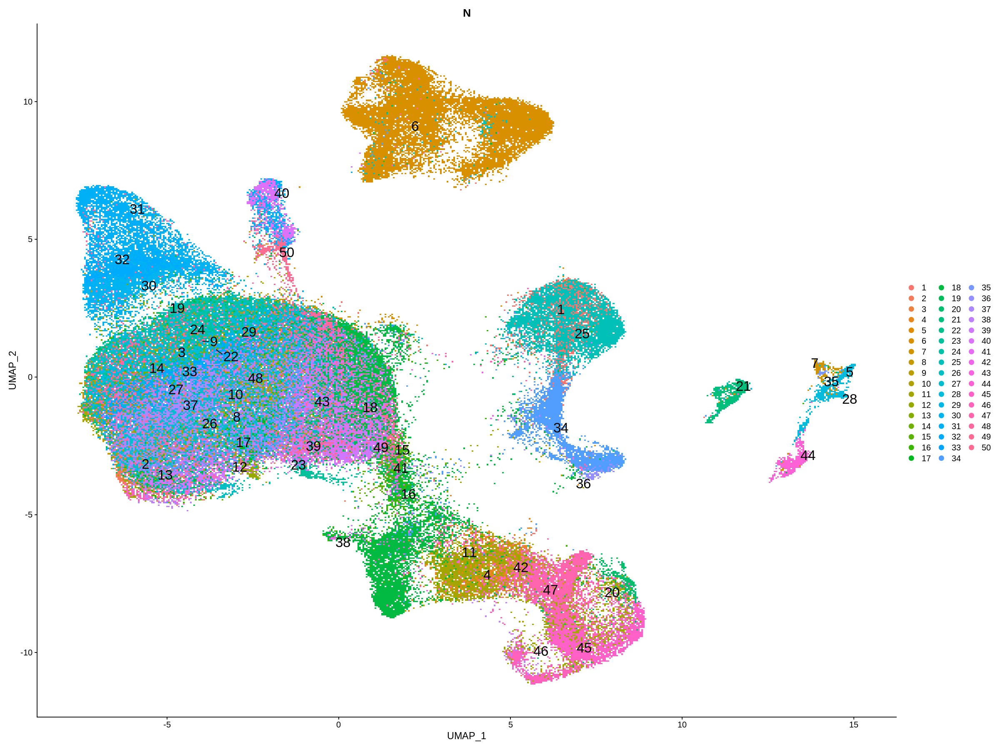

In [30]:
options(repr.plot.width = 20, repr.plot.height = 15 , ggrepel.max.overlaps = Inf)

DimPlot(skeleton.combined, group.by="N", label = TRUE, repel=TRUE, 
        order=rev(order(as.numeric(as.character(skeleton.combined$CellTypeN)))), label.size = 7)

In [31]:
ggsave("Full/output/sca_v.0.5.0_N.png", dpi = 300, width = 20, height = 15)

In [32]:
Idents(skeleton.combined) <- skeleton.combined$CellTypeN

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



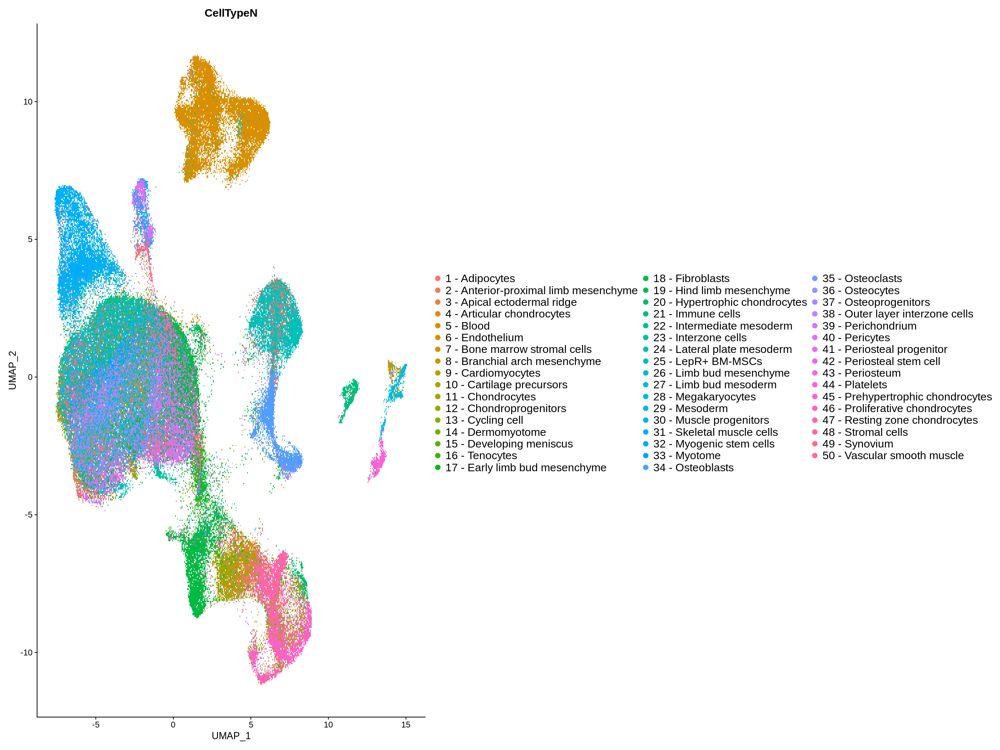

In [33]:
DimPlot(skeleton.combined, group.by="CellTypeN", order = rev(gtools::mixedsort(levels(as.factor(skeleton.combined$CellTypeN))))) + 
    theme(legend.text=element_text(size=16)) +
    theme(legend.key.height= unit(6, 'mm'),
          legend.key.width= unit(1, 'mm')) + 
    guides(fill=guide_legend(ncol=2))

In [34]:
ggsave("Full/output/sca_v.0.5.0_CellTypeN.png", dpi = 300, width = 20, height = 15)

In [35]:
Idents(skeleton.combined) <- skeleton.combined$CellTypeN

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



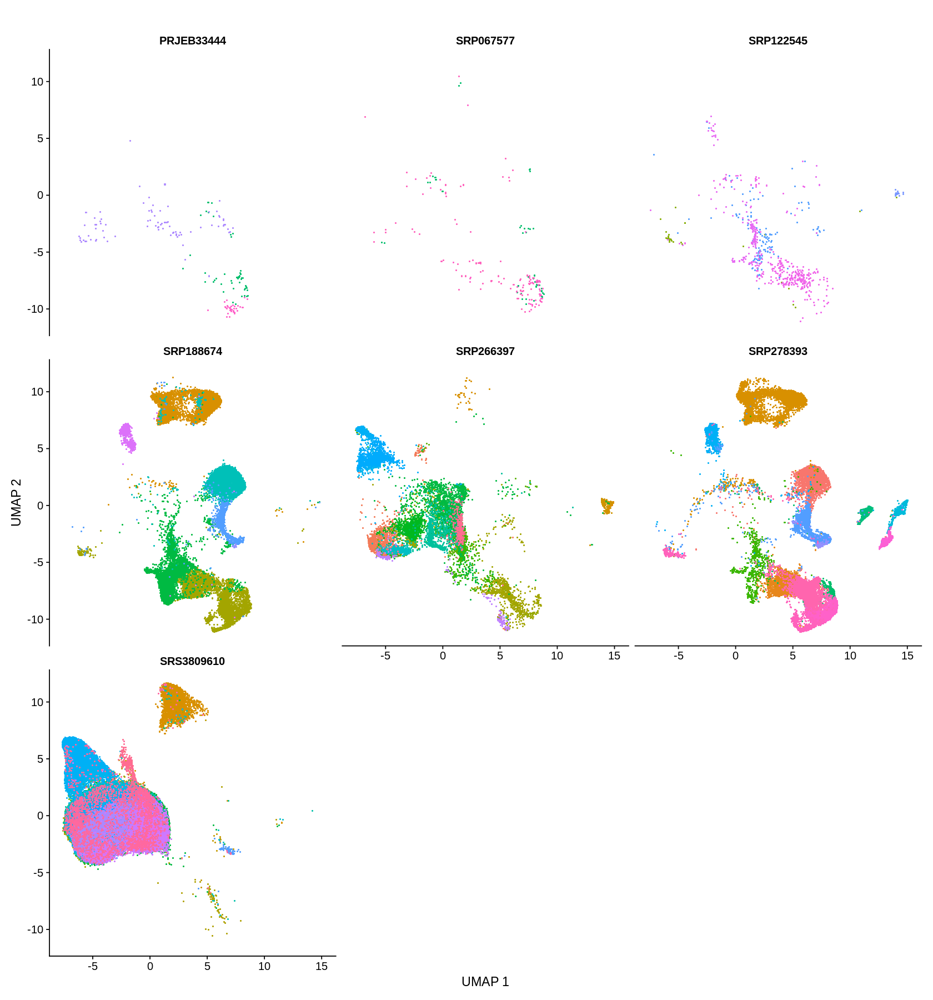

In [36]:
options(repr.plot.width=14, repr.plot.height=15)

p1 <- DimPlot(skeleton.combined, split.by = "Dataset", 
              order = rev(gtools::mixedsort(levels(as.factor(skeleton.combined$CellTypeN)))),
              label = F, raster = T, repel = T, ncol = 3) +
        xlab("UMAP 1") + ylab("UMAP 2") + ggtitle("") + NoLegend()
p1

In [37]:
ggsave("Full/output/sca_v.0.5.0_Datasets_split.png", dpi = 300, width = 14, height = 15)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



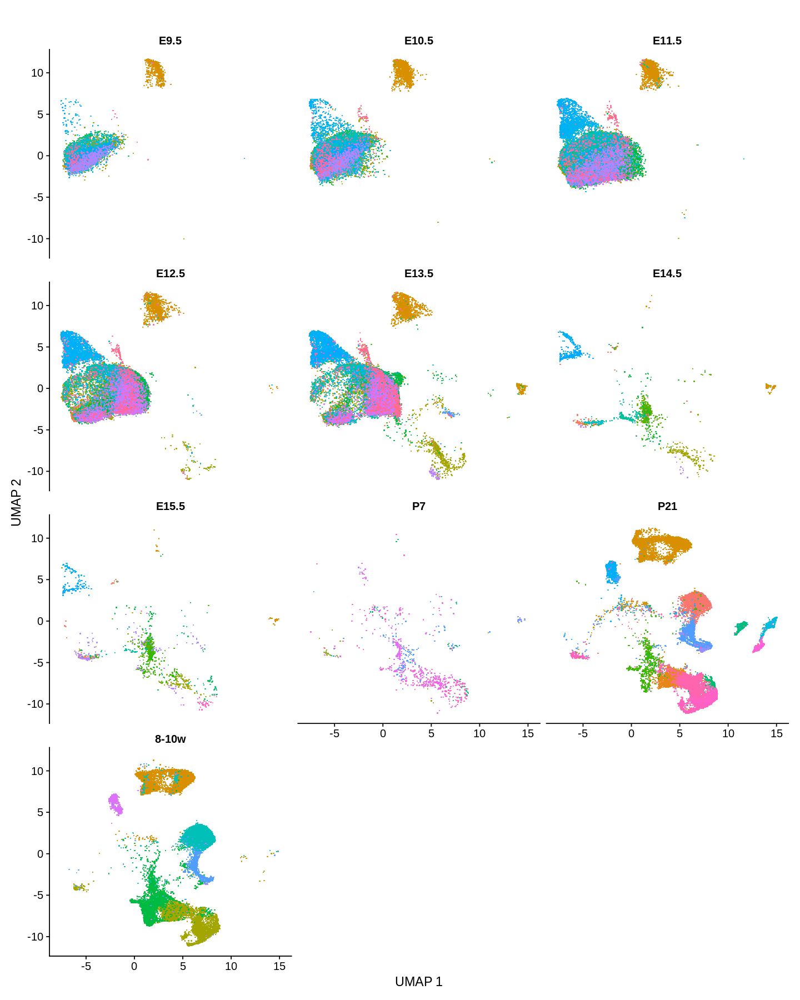

In [38]:
options(repr.plot.width=12, repr.plot.height=15)

p1 <- DimPlot(skeleton.combined, split.by = "DevTP", 
              order = rev(gtools::mixedsort(levels(as.factor(skeleton.combined$CellTypeN)))),
              label = F, raster = T, repel = T, ncol = 3) +
        xlab("UMAP 1") + ylab("UMAP 2") + ggtitle("") + NoLegend()
p1

In [39]:
ggsave("Full/output/sca_v.0.5.0_Timelapse.png", dpi = 300, width = 12, height = 15)

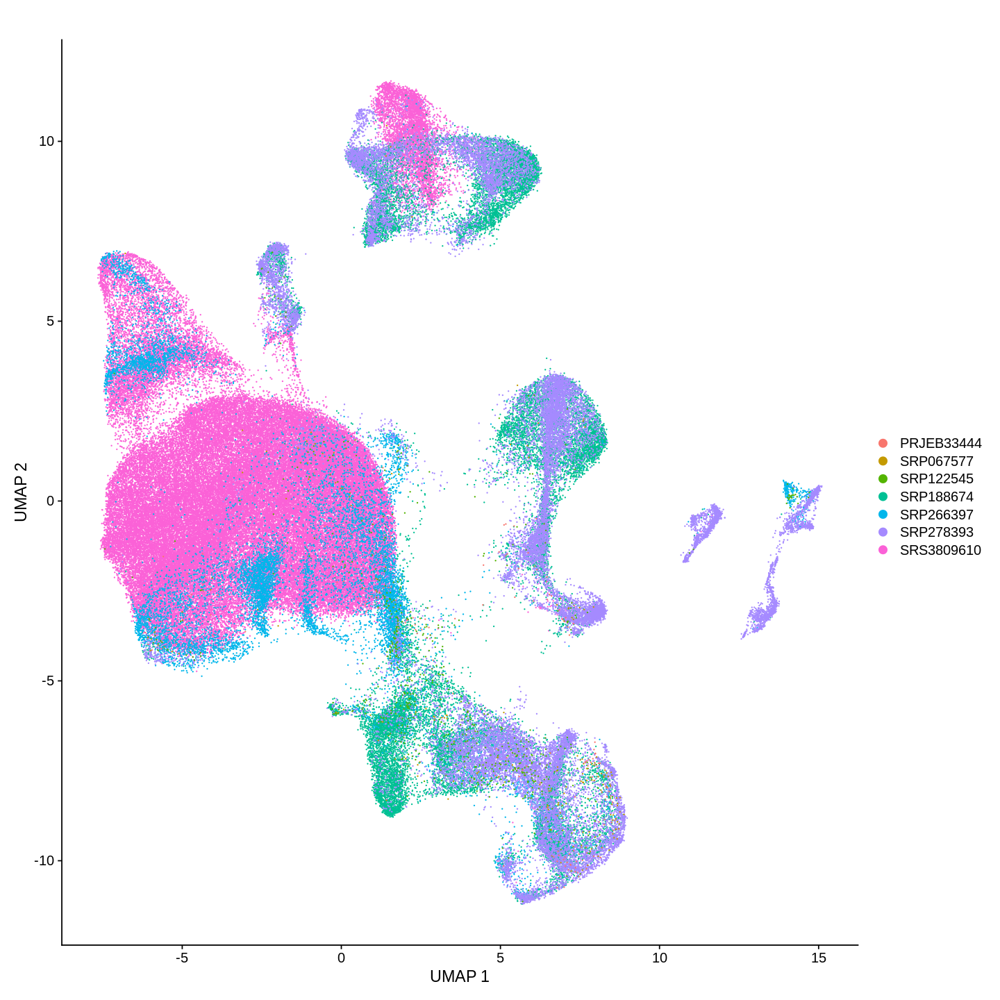

In [40]:
options(repr.plot.width=12, repr.plot.height=12)

p1 <- DimPlot(skeleton.combined, group.by = "Dataset", label = FALSE, raster = FALSE, repel = T) +
        xlab("UMAP 1") + ylab("UMAP 2") + ggtitle("")
p1

In [41]:
ggsave("Full/output/sca_v.0.5.0_Dataset.png", dpi = 300, width = 12, height = 12)

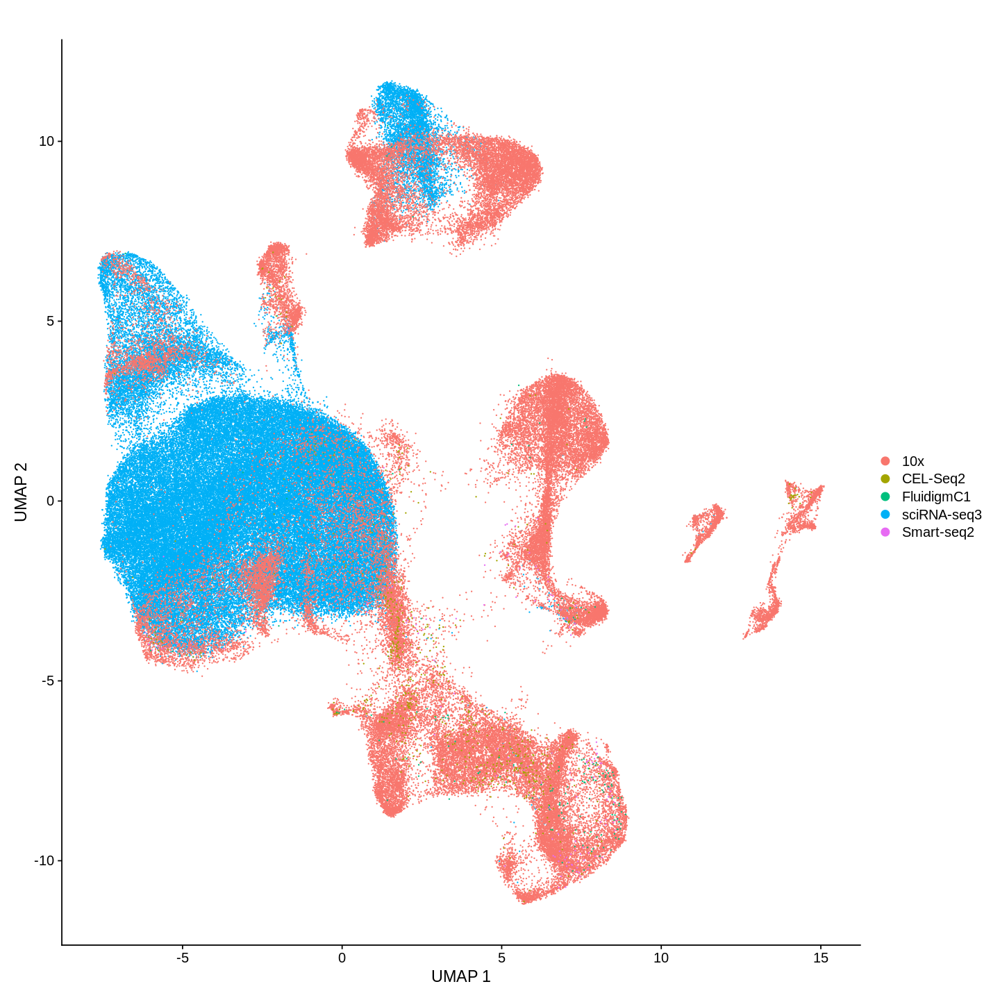

In [42]:
options(repr.plot.width=12, repr.plot.height=12)

p1 <- DimPlot(skeleton.combined, group.by = "Tech", label = FALSE, raster = FALSE, repel = T) +
        xlab("UMAP 1") + ylab("UMAP 2") + ggtitle("")
p1

In [43]:
ggsave("Full/output/sca_v.0.5.0_Tech.png", dpi = 300, width = 12, height = 12)

In [14]:
Idents(limb) <- limb$N

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



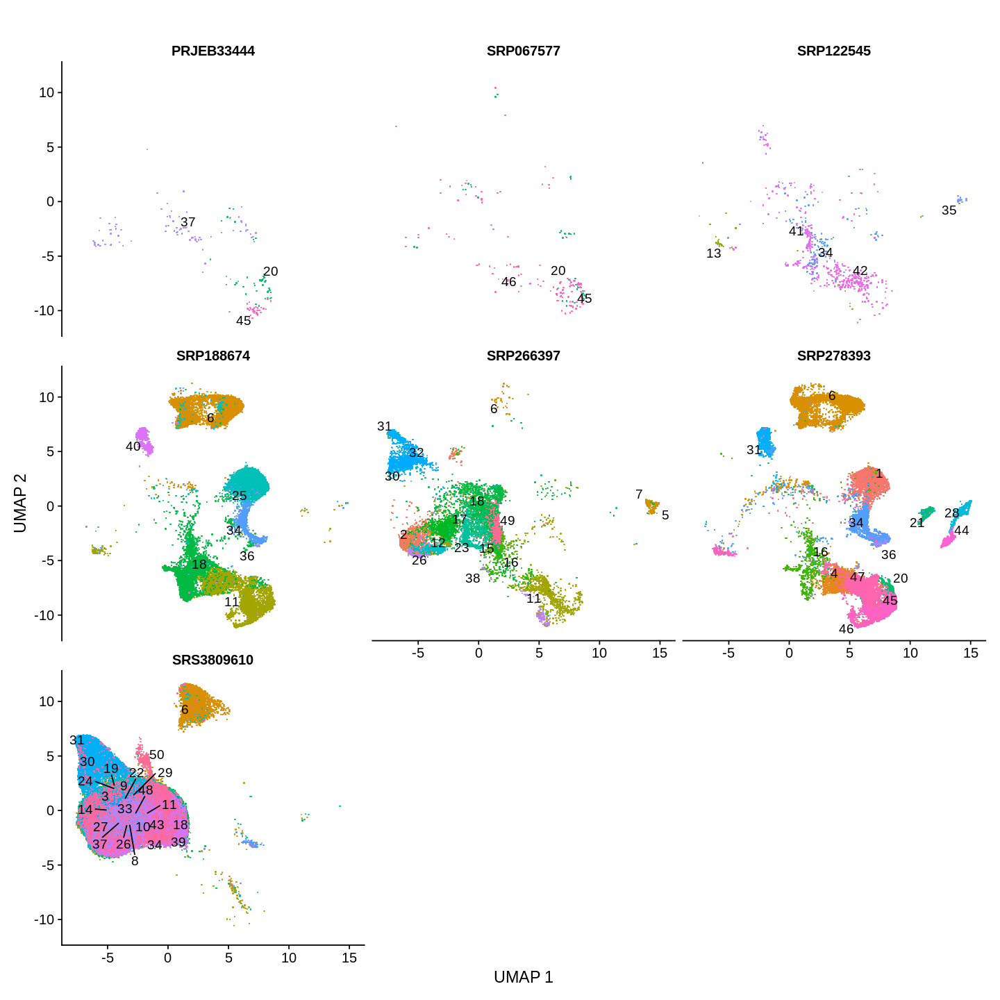

In [19]:
options(repr.plot.width=12, repr.plot.height=12, ggrepel.max.overlaps = Inf)

p1 <- DimPlot(limb, split.by = "Dataset",
              order = rev(gtools::mixedsort(levels(as.factor(limb$N)))),
              label = T, raster = T, repel = T, ncol = 3) +
        xlab("UMAP 1") + ylab("UMAP 2") + ggtitle("") + NoLegend()
p1

In [20]:
ggsave("Full/output/sca_v.0.5.0_Dataset_split.png", dpi = 300, width = 12, height = 12)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



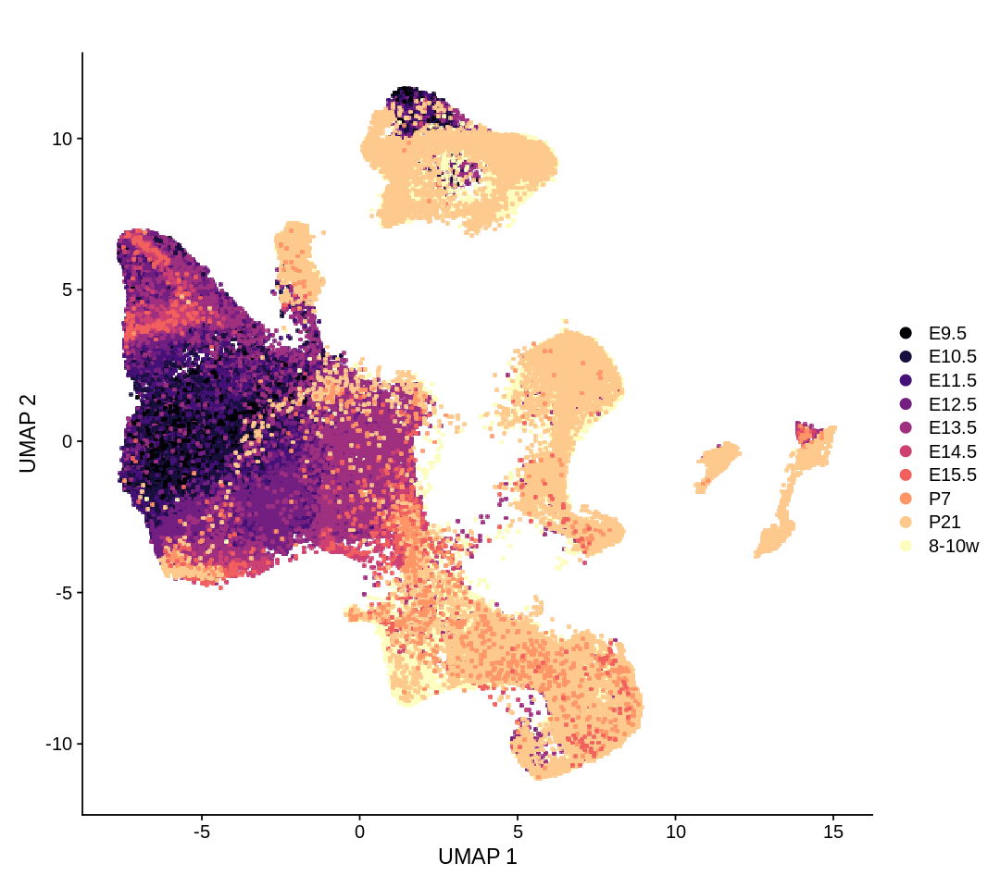

In [35]:
options(repr.plot.width=9, repr.plot.height=8, ggrepel.max.overlaps = Inf)

require("viridis")
p1 <- DimPlot(limb, group.by = "DevTP",
              # order = rev(gtools::mixedsort(levels(as.factor(limb$N)))),
              label = F, raster = T, repel = T) +
            xlab("UMAP 1") + ylab("UMAP 2") + ggtitle("") +
            scale_color_viridis(discrete = T, option = "magma")

p1

In [36]:
ggsave("Full/output/sca_v.0.5.0_Timelapse_viridis.png", dpi = 300, width = 9, height = 8)

In [44]:
saveRDS(skeleton.combined, file = "Full/RDataSessions/SCA_v.0.5.0_preprint.Rds")

In [4]:
limb <- readRDS(file = "Full/RDataSessions/SCA_v.0.5.0_with3D_preprint.Rds")
limb

An object of class Seurat 
71392 features across 150800 samples within 3 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 other assays present: RNA, originalexp
 3 dimensional reductions calculated: pca, umap, umap_3d

In [5]:
colnames(limb@meta.data)

[1] "orig.ident"                                    
 [2] "nCount_RNA"                                    
 [3] "nFeature_RNA"                                  
 [4] "id"                                            
 [5] "sex"                                           
 [6] "day"                                           
 [7] "Total_mRNAs"                                   
 [8] "tsne_1"                                        
 [9] "tsne_2"                                        
[10] "Main_Cluster"                                  
[11] "sub_tsne_1"                                    
[12] "sub_tsne_2"                                    
[13] "Sub_Cluster"                                   
[14] "db_score"                                      
[15] "detected_doublet"                              
[16] "potential_doublet_cluster"                     
[17] "percent.mito"                                  
[18] "S.Score"                                       
[19] "G2M.Score"                                     
[20] "Phase"                                         
[21] "old.ident"                                     
[22] "CC.Difference"                                 
[23] "RNA_snn_res.1.5"                               
[24] "seurat_clusters"                               
[25] "Annotation"                                    
[26] "labels"                                        
[27] "Organism"                                      
[28] "DevTP"                                         
[29] "Dataset"                                       
[30] "Tech"                                          
[31] "Author"                                        
[32] "CellType"                                      
[33] "Origin"                                        
[34] "Identity"                                      
[35] "percent.mt"                                    
[36] "RNA_snn_res.0.5"                               
[37] "RNA_snn_res.0.11"                              
[38] "Cells"                                         
[39] "is_cell_control"                               
[40] "total_features_by_counts"                      
[41] "log10_total_features_by_counts"                
[42] "total_counts"                                  
[43] "log10_total_counts"                            
[44] "pct_counts_in_top_50_features"                 
[45] "pct_counts_in_top_100_features"                
[46] "pct_counts_in_top_200_features"                
[47] "pct_counts_in_top_500_features"                
[48] "total_features_by_counts_endogenous"           
[49] "log10_total_features_by_counts_endogenous"     
[50] "total_counts_endogenous"                       
[51] "log10_total_counts_endogenous"                 
[52] "pct_counts_endogenous"                         
[53] "pct_counts_in_top_50_features_endogenous"      
[54] "pct_counts_in_top_100_features_endogenous"     
[55] "pct_counts_in_top_200_features_endogenous"     
[56] "pct_counts_in_top_500_features_endogenous"     
[57] "total_features_by_counts_feature_control"      
[58] "log10_total_features_by_counts_feature_control"
[59] "total_counts_feature_control"                  
[60] "log10_total_counts_feature_control"            
[61] "pct_counts_feature_control"                    
[62] "pct_counts_in_top_50_features_feature_control" 
[63] "pct_counts_in_top_100_features_feature_control"
[64] "pct_counts_in_top_200_features_feature_control"
[65] "pct_counts_in_top_500_features_feature_control"
[66] "total_features_by_counts_Mt"                   
[67] "log10_total_features_by_counts_Mt"             
[68] "total_counts_Mt"                               
[69] "log10_total_counts_Mt"                         
[70] "pct_counts_Mt"                                 
[71] "pct_counts_in_top_50_features_Mt"              
[72] "pct_counts_in_top_100_features_Mt"             
[73] "pct_counts_in_top_200_features_Mt"             
[74] "pct_counts_in_top_500_features_Mt"             
[75] 

In [6]:
umap_1 <- limb[["umap_3d"]]@cell.embeddings[,1]
umap_2 <- limb[["umap_3d"]]@cell.embeddings[,2]
umap_3 <- limb[["umap_3d"]]@cell.embeddings[,3]

In [7]:
plot.data <- FetchData(object = limb, vars = c("umap_3d_1", "umap_3d_2", "umap_3d_3", "UMAP_1", "UMAP_2", 
                                               "Tech", "Organism", "DevTP", "Identity", "Author"))
head(plot.data)

,umap_3d_1,umap_3d_2,umap_3d_3,UMAP_1,UMAP_2,Tech,Organism,DevTP,Identity,Author
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<fct>,<fct>,<fct>
sci3-me-164.TAAGACCGTAACGGACCAA,1.3004284,-4.0251141,6.4332299,-7.431513,6.7933097,sciRNA-seq3,Mus musculus,E13.5,Skeletal muscle cells,Cao
sci3-me-115.GCGGAGAATAGTAAGCATA,2.0866472,2.2872755,0.3049501,0.494439,-3.1703844,sciRNA-seq3,Mus musculus,E13.5,Fibroblasts,Cao
sci3-me-106.GGTCCTTCTGGTACTGCCT,-0.2362919,-7.7520943,-0.5800926,2.898548,9.0226999,sciRNA-seq3,Mus musculus,E9.5,Endothelium,Cao
sci3-me-646.AAAGCTGATTTTAATTGAAT,0.7018481,-9.3281599,0.9059936,1.373685,11.4905458,sciRNA-seq3,Mus musculus,E11.5,Endothelium,Cao
sci3-me-197.TAGATGACTTCAACCAGTAC,0.7241499,-9.4683424,0.5426561,1.425852,11.2120233,sciRNA-seq3,Mus musculus,E11.5,Endothelium,Cao
sci3-me-326.AAGGATTACTCAACCGCTAA,-1.4902803,0.9528558,2.8703777,-2.961544,-0.2018268,sciRNA-seq3,Mus musculus,E10.5,Cardiomyocytes,Cao


In [8]:
metadata_webapp = plot.data
colnames(metadata_webapp) <- c("umap_3d_1", "umap_3d_2", "umap_3d_3", "umap_1", "umap_2", 
                               "tech", "organism", "devtp", "identity", "author")
head(metadata_webapp)

,umap_3d_1,umap_3d_2,umap_3d_3,umap_1,umap_2,tech,organism,devtp,identity,author
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<fct>,<fct>,<fct>
sci3-me-164.TAAGACCGTAACGGACCAA,1.3004284,-4.0251141,6.4332299,-7.431513,6.7933097,sciRNA-seq3,Mus musculus,E13.5,Skeletal muscle cells,Cao
sci3-me-115.GCGGAGAATAGTAAGCATA,2.0866472,2.2872755,0.3049501,0.494439,-3.1703844,sciRNA-seq3,Mus musculus,E13.5,Fibroblasts,Cao
sci3-me-106.GGTCCTTCTGGTACTGCCT,-0.2362919,-7.7520943,-0.5800926,2.898548,9.0226999,sciRNA-seq3,Mus musculus,E9.5,Endothelium,Cao
sci3-me-646.AAAGCTGATTTTAATTGAAT,0.7018481,-9.3281599,0.9059936,1.373685,11.4905458,sciRNA-seq3,Mus musculus,E11.5,Endothelium,Cao
sci3-me-197.TAGATGACTTCAACCAGTAC,0.7241499,-9.4683424,0.5426561,1.425852,11.2120233,sciRNA-seq3,Mus musculus,E11.5,Endothelium,Cao
sci3-me-326.AAGGATTACTCAACCGCTAA,-1.4902803,0.9528558,2.8703777,-2.961544,-0.2018268,sciRNA-seq3,Mus musculus,E10.5,Cardiomyocytes,Cao


In [9]:
library(data.table)
write.table(metadata_webapp, file = "metadata_webapp.csv", sep = ",", row.names = FALSE, quote = FALSE)


Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last


The following object is masked from ‘package:SummarizedExperiment’:

    shift


The following object is masked from ‘package:GenomicRanges’:

    shift


The following object is masked from ‘package:IRanges’:

    shift


The following objects are masked from ‘package:S4Vectors’:

    first, second




### Adams

In [84]:
bc <- grep("Sivaraj", skeleton.combined$Author)

In [85]:
barcodes <- rownames(skeleton.combined@meta.data[bc,])

In [86]:
subset <- subset(skeleton.combined, cells = barcodes)
adams$CellTypeN <- subset$CellTypeN
adams$N <- subset$N

In [87]:
ds <- subset(adams, cells = barcodes)
ds

An object of class Seurat 
16537 features across 26295 samples within 1 assay 
Active assay: RNA (16537 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

Warning message in eval(quote(list(...)), env):
“NAs introduced by coercion”


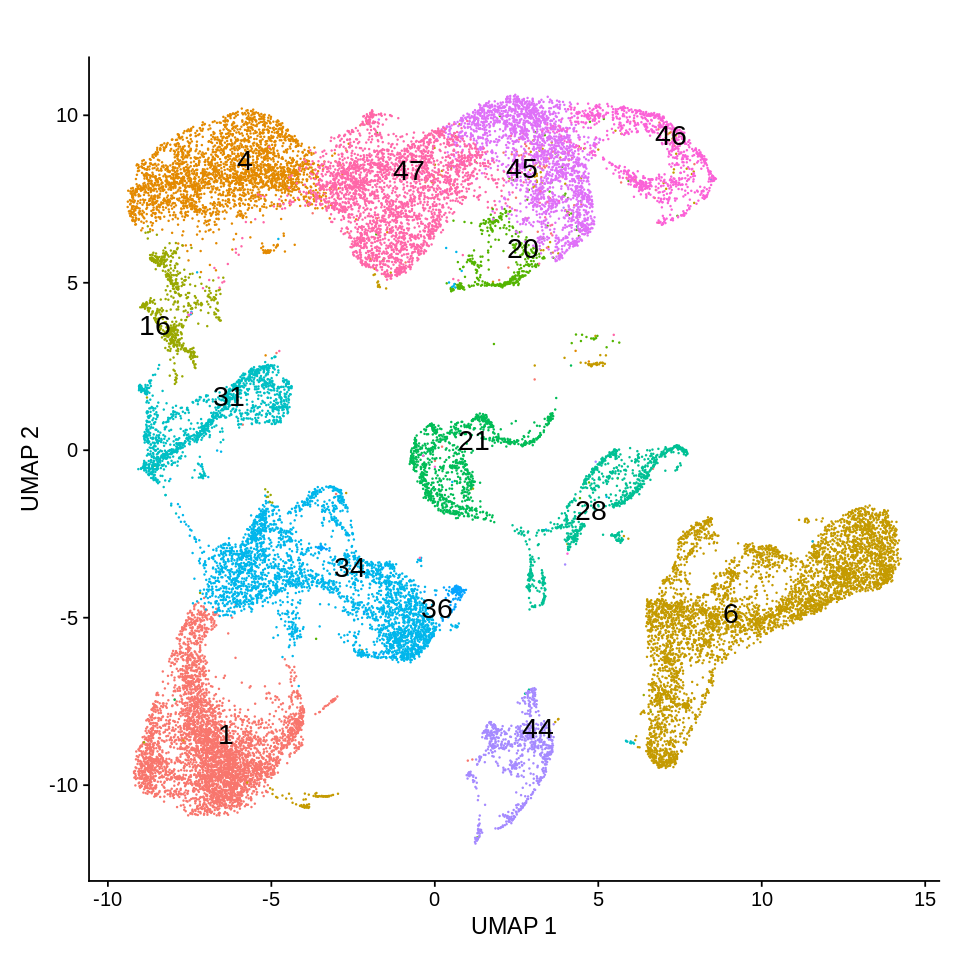

In [90]:
options(repr.plot.width = 8, repr.plot.height = 8 , ggrepel.max.overlaps = Inf)

DimPlot(ds, group.by="N", label = TRUE, repel=TRUE, 
        order=rev(order(as.numeric(as.character(ds$CellTypeN)))), label.size = 6) + NoLegend() + 
    xlab("UMAP 1") + 
    ylab("UMAP 2") + ggtitle("")

In [91]:
ggsave("Full/output/adams_v.0.5.0_N.png", dpi = 300, width = 8, height = 8)

### Baryawno

In [92]:
bc <- grep("Baryawno", skeleton.combined$Author)

In [93]:
barcodes <- rownames(skeleton.combined@meta.data[bc,])

In [94]:
subset <- subset(skeleton.combined, cells = barcodes)
baryawno$CellTypeN <- subset$CellTypeN
baryawno$N <- subset$N

In [95]:
ds <- subset(baryawno, cells = barcodes)
ds

An object of class Seurat 
27998 features across 24652 samples within 1 assay 
Active assay: RNA (27998 features, 2000 variable features)
 3 dimensional reductions calculated: pca, tsne, umap

Warning message in eval(quote(list(...)), env):
“NAs introduced by coercion”


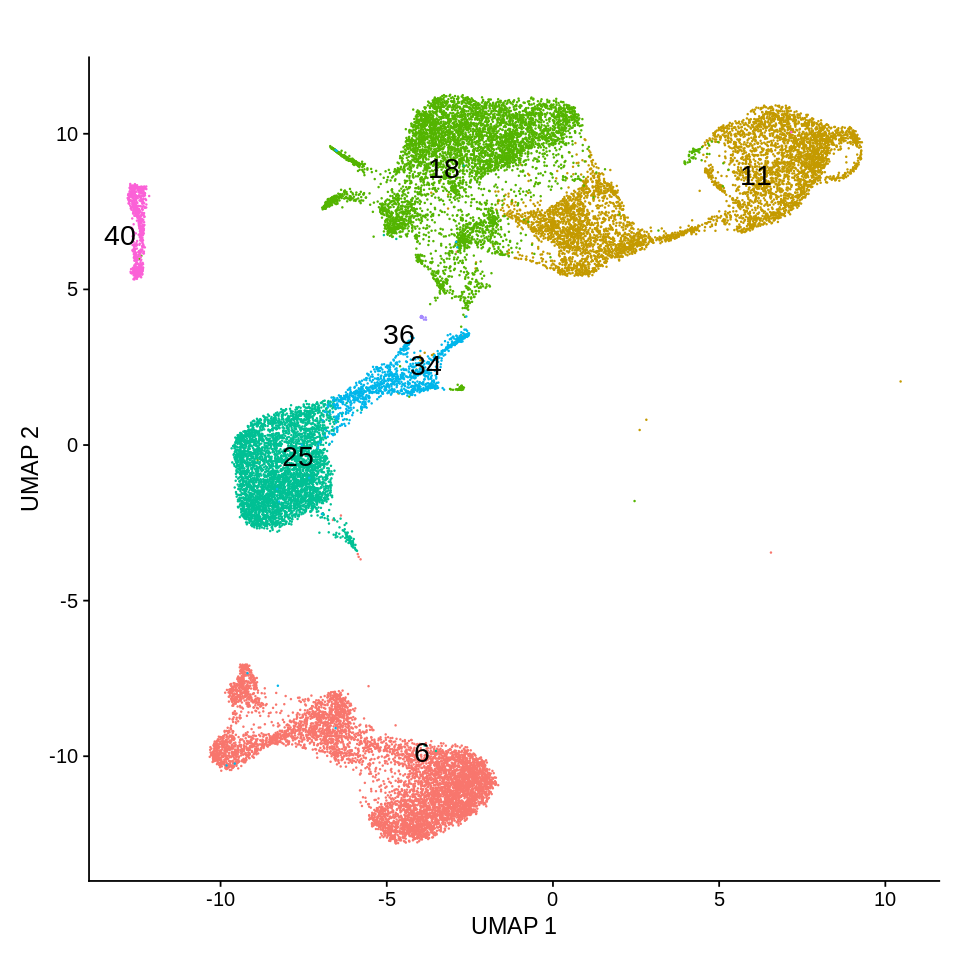

In [96]:
options(repr.plot.width = 8, repr.plot.height = 8 , ggrepel.max.overlaps = Inf)

DimPlot(ds, group.by="N", label = TRUE, repel=TRUE, 
        order=rev(order(as.numeric(as.character(ds$CellTypeN)))), label.size = 6) + NoLegend() + 
    xlab("UMAP 1") + 
    ylab("UMAP 2") + ggtitle("")

In [97]:
ggsave("Full/output/baryawno_v.0.5.0_N.png", dpi = 300, width = 8, height = 8)

### Bian

In [98]:
bc <- grep("Bian", skeleton.combined$Author)

In [99]:
barcodes <- rownames(skeleton.combined@meta.data[bc,])

In [100]:
subset <- subset(skeleton.combined, cells = barcodes)
bian$CellTypeN <- subset$CellTypeN
bian$N <- subset$N

In [101]:
ds <- subset(bian, cells = barcodes)
ds

An object of class Seurat 
16685 features across 11295 samples within 1 assay 
Active assay: RNA (16685 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, tsne

Warning message in eval(quote(list(...)), env):
“NAs introduced by coercion”


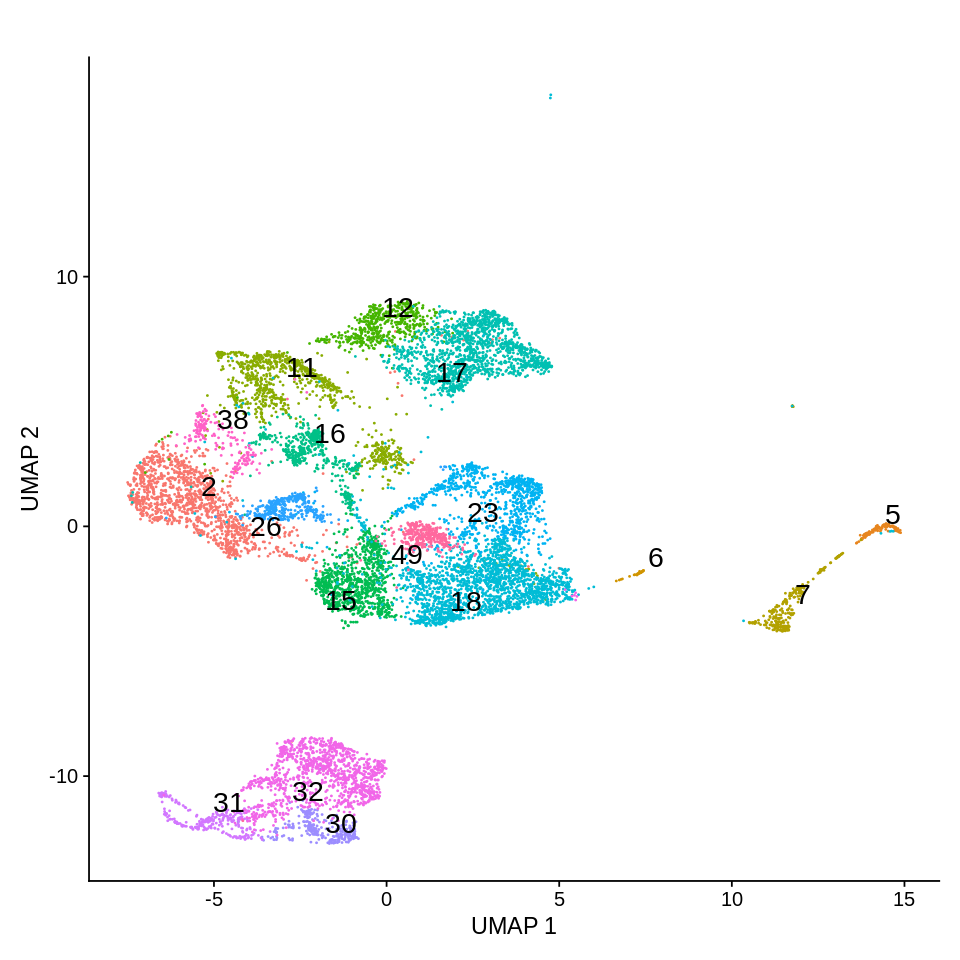

In [102]:
options(repr.plot.width = 8, repr.plot.height = 8 , ggrepel.max.overlaps = Inf)

DimPlot(ds, group.by="N", label = TRUE, repel=TRUE, 
        order=rev(order(as.numeric(as.character(ds$CellTypeN)))), label.size = 6) + NoLegend() + 
    xlab("UMAP 1") + 
    ylab("UMAP 2") + ggtitle("")

In [103]:
ggsave("Full/output/bian_v.0.5.0_N.png", dpi = 300, width = 8, height = 8)

### Bohm

In [107]:
bc <- grep("Böhm", skeleton.combined$Author)

In [108]:
barcodes <- rownames(skeleton.combined@meta.data[bc,])

In [109]:
subset <- subset(skeleton.combined, cells = barcodes)
bohm$CellTypeN <- subset$CellTypeN
bohm$N <- subset$N

In [110]:
ds <- subset(bohm, cells = barcodes)
ds

An object of class Seurat 
27343 features across 168 samples within 1 assay 
Active assay: originalexp (27343 features, 2000 variable features)
 4 dimensional reductions calculated: PCA_coldata, pca, tsne, umap

Warning message in eval(quote(list(...)), env):
“NAs introduced by coercion”


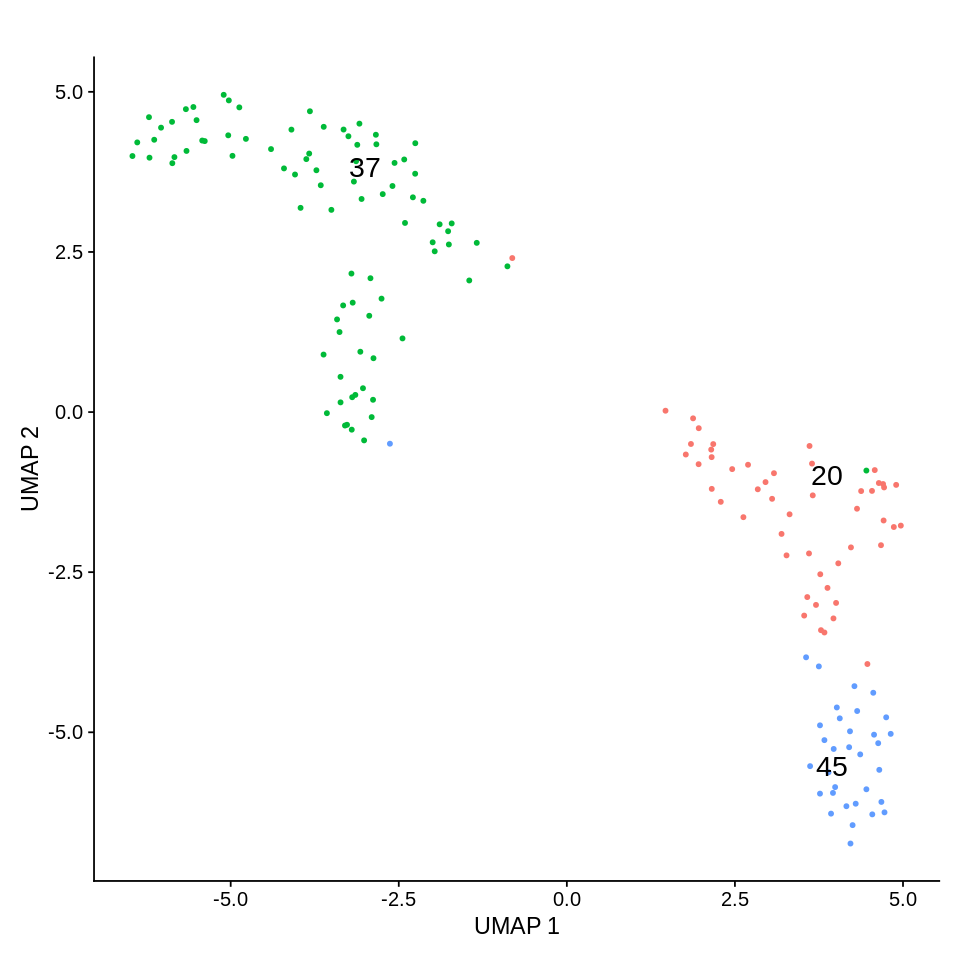

In [111]:
options(repr.plot.width = 8, repr.plot.height = 8 , ggrepel.max.overlaps = Inf)

DimPlot(ds, group.by="N", label = TRUE, repel=TRUE, 
        order=rev(order(as.numeric(as.character(ds$CellTypeN)))), label.size = 6) + NoLegend() + 
    xlab("UMAP 1") + 
    ylab("UMAP 2") + ggtitle("")

In [112]:
ggsave("Full/output/bohm_v.0.5.0_N.png", dpi = 300, width = 8, height = 8)

### Li

In [113]:
bc <- grep("Li", skeleton.combined$Author)

In [114]:
barcodes <- rownames(skeleton.combined@meta.data[bc,])

In [115]:
subset <- subset(skeleton.combined, cells = barcodes)
li$CellTypeN <- subset$CellTypeN
li$N <- subset$N

In [116]:
ds <- subset(li, cells = barcodes)
ds

An object of class Seurat 
22893 features across 186 samples within 1 assay 
Active assay: RNA (22893 features, 2000 variable features)
 3 dimensional reductions calculated: PCA_coldata, pca, tsne

Warning message in eval(quote(list(...)), env):
“NAs introduced by coercion”


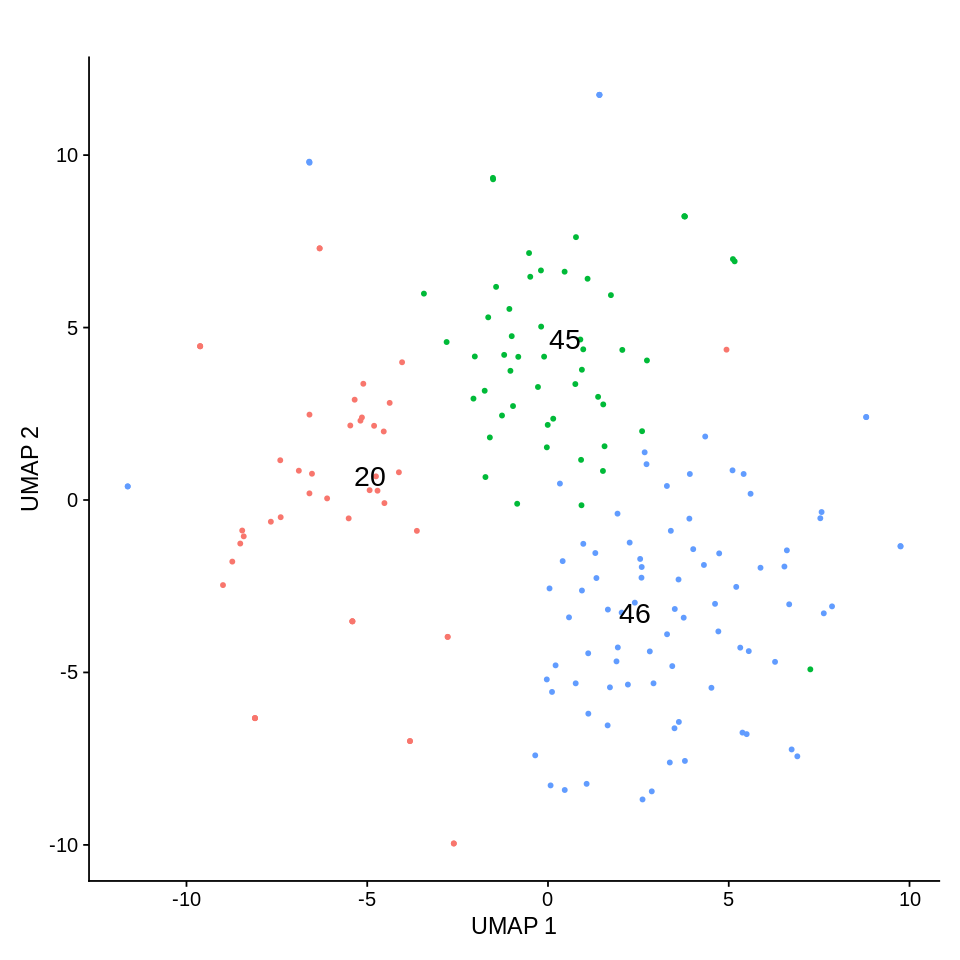

In [117]:
options(repr.plot.width = 8, repr.plot.height = 8 , ggrepel.max.overlaps = Inf)

DimPlot(ds, group.by="N", label = TRUE, repel=TRUE, 
        order=rev(order(as.numeric(as.character(ds$CellTypeN)))), label.size = 6) + NoLegend() + 
    xlab("UMAP 1") + 
    ylab("UMAP 2") + ggtitle("")

In [118]:
ggsave("Full/output/li_v.0.5.0_N.png", dpi = 300, width = 8, height = 8)

### Debnath

In [119]:
bc <- grep("Debnath", skeleton.combined$Author)

In [120]:
barcodes <- rownames(skeleton.combined@meta.data[bc,])

In [121]:
subset <- subset(skeleton.combined, cells = barcodes)
debnath$CellTypeN <- subset$CellTypeN
debnath$N <- subset$N

In [122]:
ds <- subset(debnath, cells = barcodes)
ds

An object of class Seurat 
25534 features across 656 samples within 1 assay 
Active assay: RNA (25534 features, 1431 variable features)
 4 dimensional reductions calculated: PCA_coldata, pca, tSNE, umap

Warning message in eval(quote(list(...)), env):
“NAs introduced by coercion”


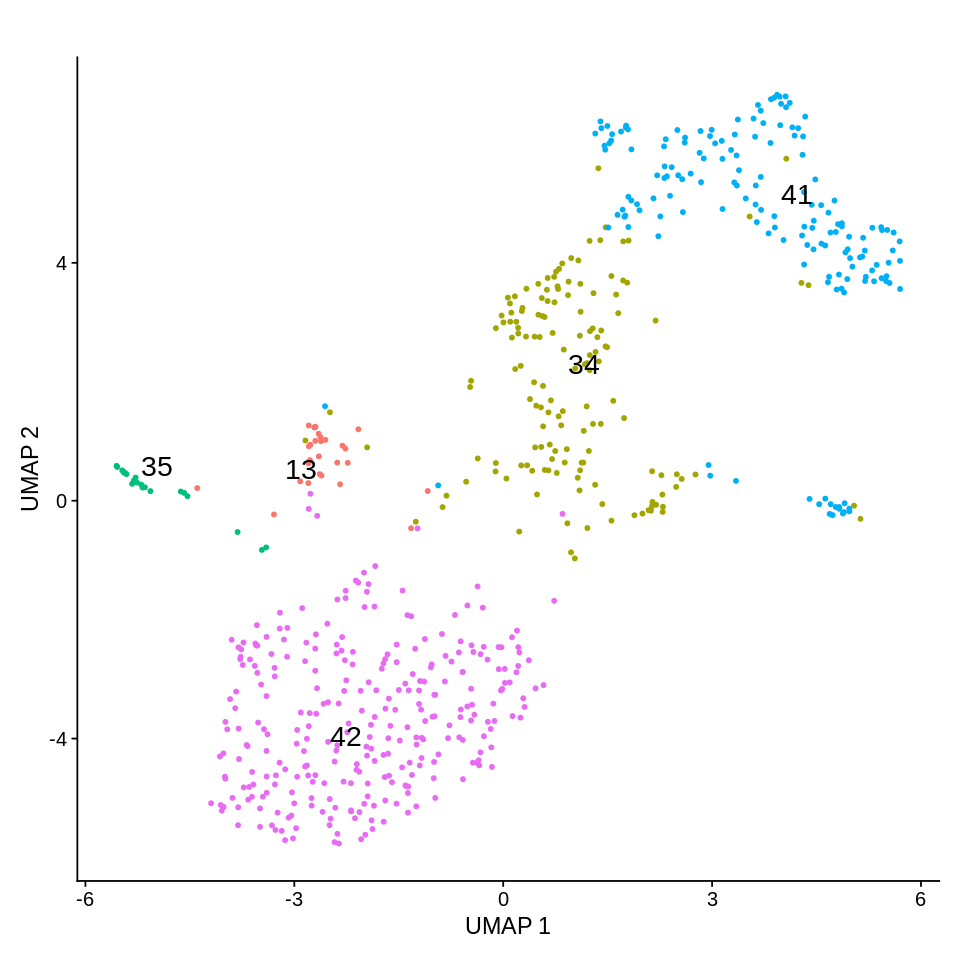

In [123]:
options(repr.plot.width = 8, repr.plot.height = 8 , ggrepel.max.overlaps = Inf)

DimPlot(ds, group.by="N", label = TRUE, repel=TRUE, 
        order=rev(order(as.numeric(as.character(ds$CellTypeN)))), label.size = 6) + NoLegend() + 
    xlab("UMAP 1") + 
    ylab("UMAP 2") + ggtitle("")

In [124]:
ggsave("Full/output/debnath_v.0.5.0_N.png", dpi = 300, width = 8, height = 8)

### Cao

In [125]:
bc <- grep("Cao", skeleton.combined$Author)

In [126]:
barcodes <- rownames(skeleton.combined@meta.data[bc,])

In [127]:
subset <- subset(skeleton.combined, cells = barcodes)
cao$CellTypeN <- subset$CellTypeN
cao$N <- subset$N

In [128]:
ds <- subset(cao, cells = barcodes)
ds

An object of class Seurat 
26183 features across 87548 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

Warning message in eval(quote(list(...)), env):
“NAs introduced by coercion”


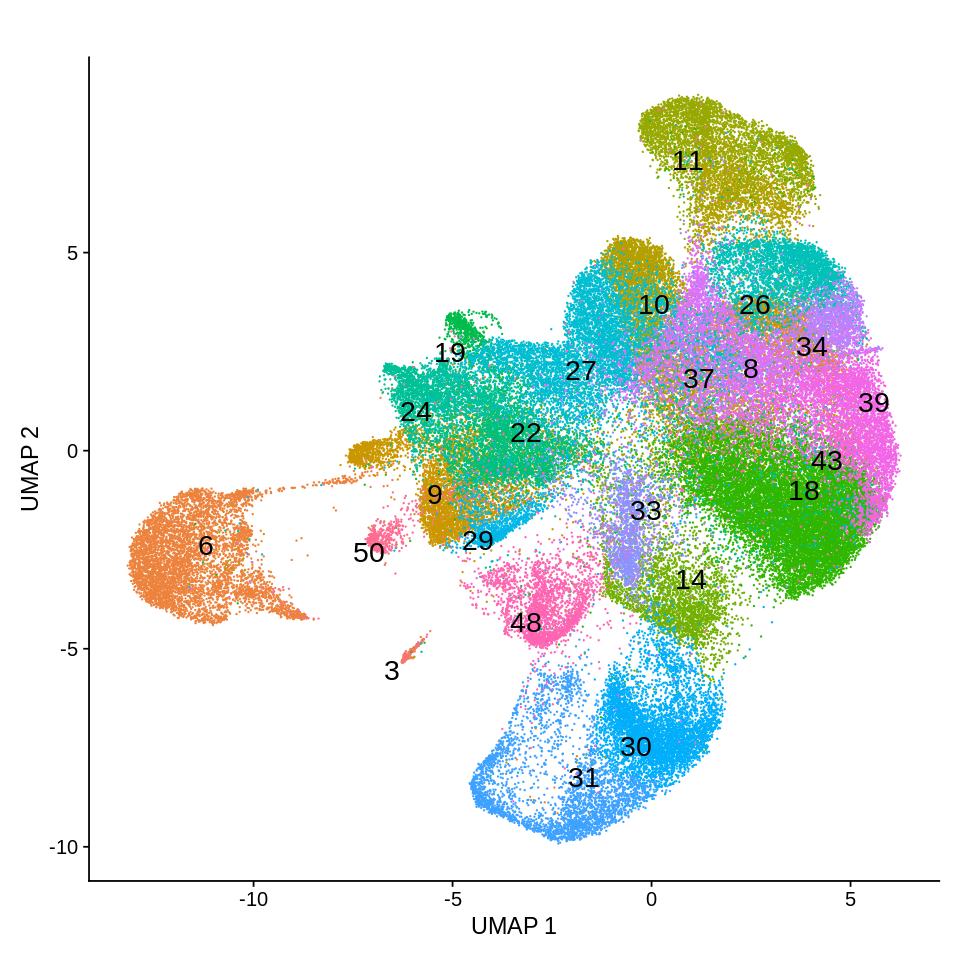

In [129]:
options(repr.plot.width = 8, repr.plot.height = 8 , ggrepel.max.overlaps = Inf)

DimPlot(ds, group.by="N", label = TRUE, repel=TRUE, 
        order=rev(order(as.numeric(as.character(ds$CellTypeN)))), label.size = 6) + NoLegend() + 
    xlab("UMAP 1") + 
    ylab("UMAP 2") + ggtitle("")

In [130]:
ggsave("Full/output/cao_v.0.5.0_N.png", dpi = 300, width = 8, height = 8)

### Cao

In [45]:
cao_bc <- grep("Cao", skeleton.combined$Author)

In [46]:
barcodes <- rownames(skeleton.combined@meta.data[cao_bc,])

In [47]:
cao_subset <- subset(skeleton.combined, cells = barcodes)
cao$CellTypeN <- cao_subset$CellTypeN
cao$N <- cao_subset$N

In [48]:
cao <- subset(cao, cells = cells.to.keep)
cao

An object of class Seurat 
26183 features across 87548 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [49]:
cao$N <- revalue(as.factor(cao$N), c("29" = "18"))
cao$CellTypeN <- revalue(cao$CellTypeN, c("29 - Mesenchymal progenitors" = "18 - Fibroblasts"))

The following `from` values were not present in `x`: 29 - Mesenchymal progenitors



Warning message in eval(quote(list(...)), env):
“NAs introduced by coercion”


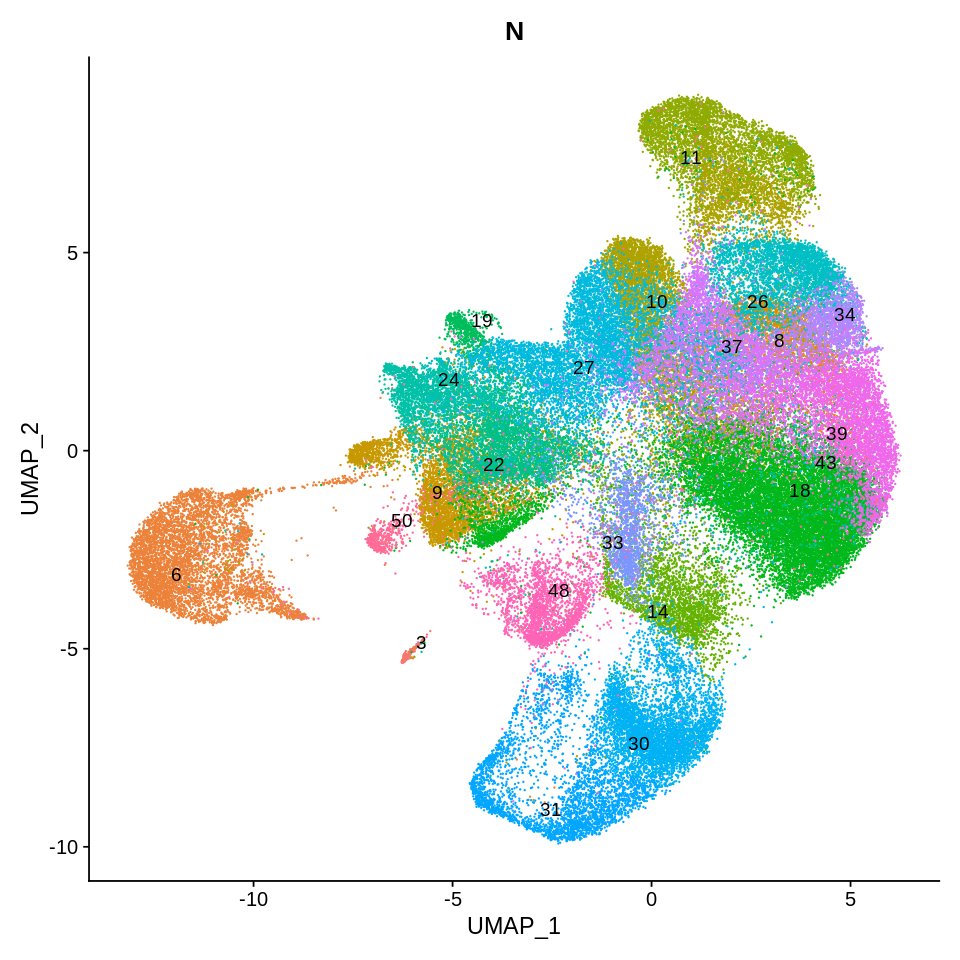

In [50]:
options(repr.plot.width = 8, repr.plot.height = 8 , ggrepel.max.overlaps = Inf)

DimPlot(cao, group.by="N", label = TRUE, repel=TRUE, 
        order=rev(order(as.numeric(as.character(cao$CellTypeN)))), label.size = 4) + NoLegend()

In [51]:
ggsave("Full/output/cao_v.0.5.0_N.png", dpi = 300, width = 8, height = 8)

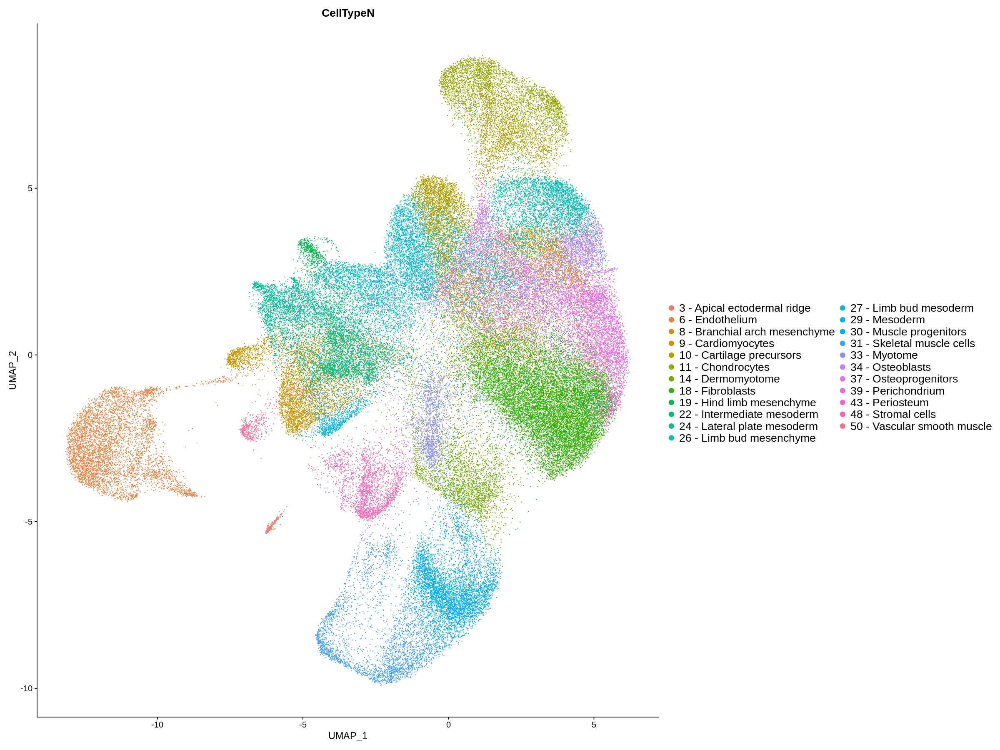

In [52]:
options(repr.plot.width = 20, repr.plot.height = 15 , ggrepel.max.overlaps = Inf)

DimPlot(cao, group.by="CellTypeN", order = rev(gtools::mixedsort(levels(as.factor(cao$CellTypeN))))) + 
    theme(legend.text=element_text(size=16)) +
    theme(legend.key.height= unit(6, 'mm'),
          legend.key.width= unit(1, 'mm')) + 
    guides(fill=guide_legend(ncol=2))

In [53]:
ggsave("Full/output/cao_v.0.5.0_CellTypeN.png", dpi = 300, width = 20, height = 15)

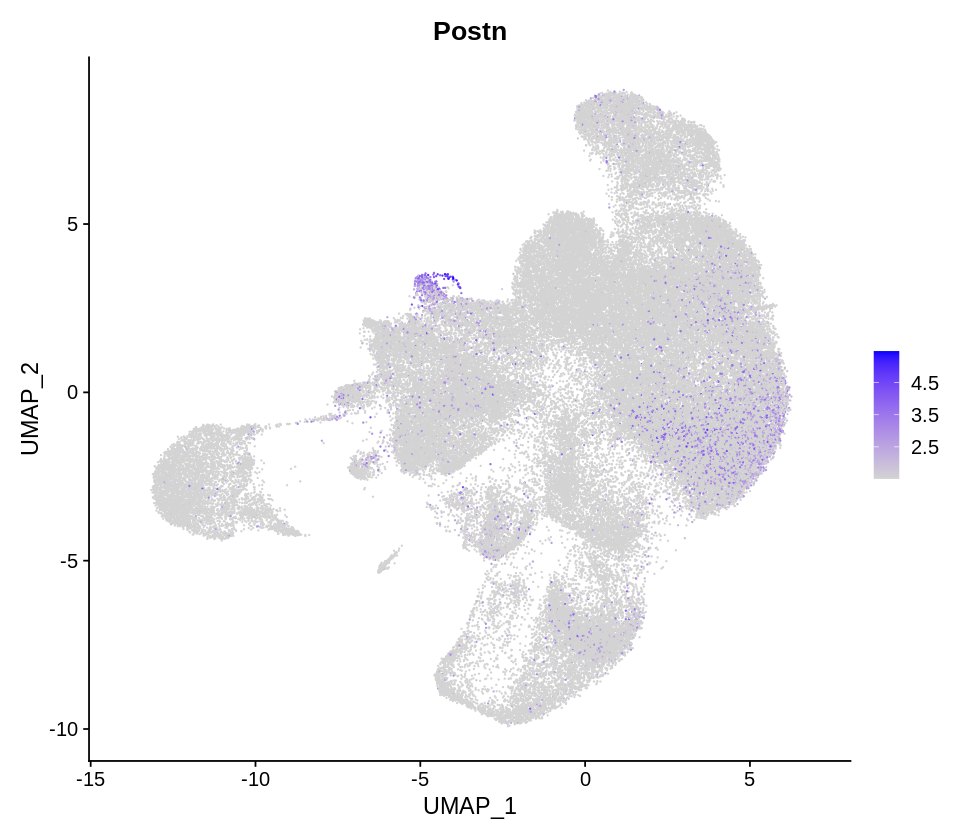

In [54]:
options(repr.plot.width = 8, repr.plot.height = 7 , ggrepel.max.overlaps = Inf)

FeaturePlot(cao, c("Postn"), min.cutoff = "q1")

In [55]:
ggsave("Full/output/cao_v.0.5.0_postn.png", dpi = 300, width = 8, height = 7)

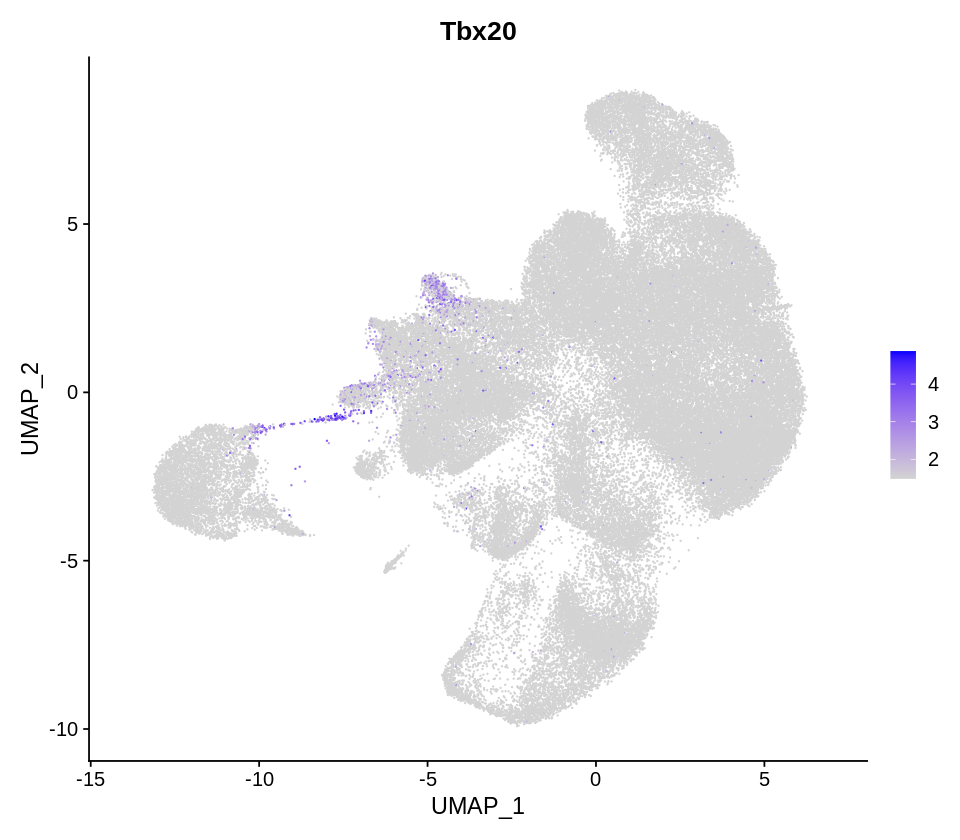

In [56]:
options(repr.plot.width = 8, repr.plot.height = 7 , ggrepel.max.overlaps = Inf)

FeaturePlot(cao, c("Tbx20"), min.cutoff = "q1")

In [57]:
ggsave("Full/output/cao_v.0.5.0_tbx20.png", dpi = 300, width = 8, height = 7)

### Convert to celldataset

In [58]:
cds <- as.cell_data_set(cao)
cds <- cluster_cells(cds)
p1 <- plot_cells(cds, show_trajectory_graph = FALSE)
p2 <- plot_cells(cds, color_cells_by = "partition", show_trajectory_graph = FALSE)

In [59]:
tail(names(colData(cds)))

[1] "Author"      "CellType"    "CellTypeN"   "N"           "ident"      
[6] "Size_Factor"

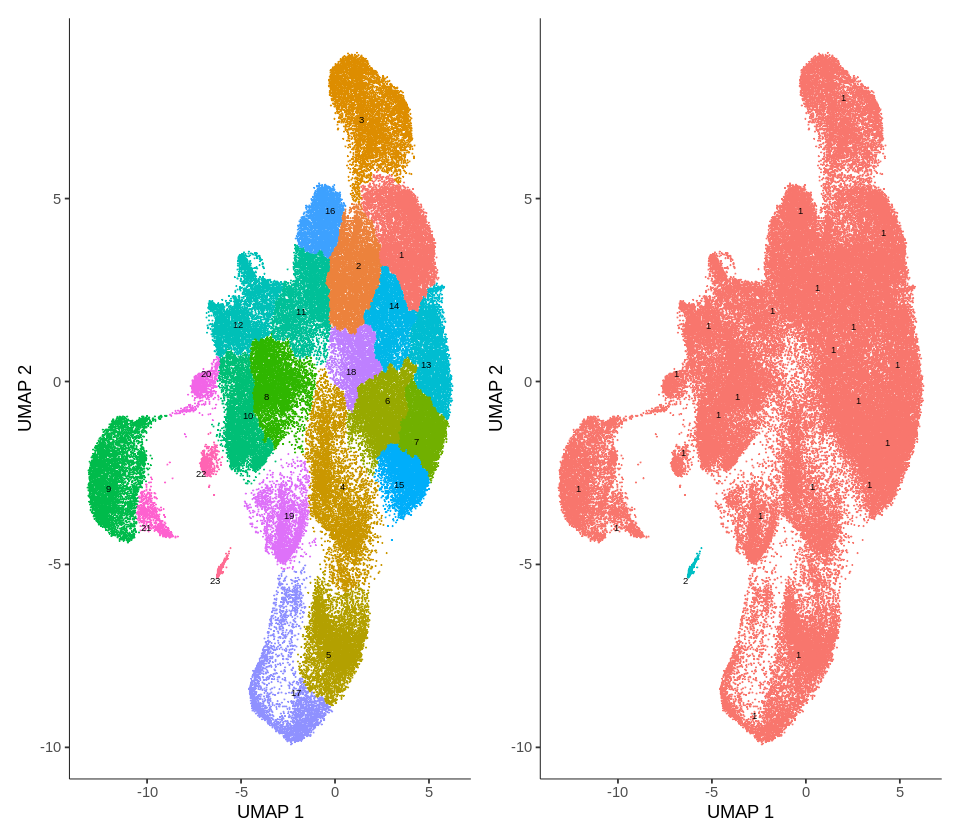

In [60]:
p1 + p2

  |======================================================================| 100%


Warning message:
“`select_()` was deprecated in dplyr 0.7.0.
Please use `select()` instead.
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated.”


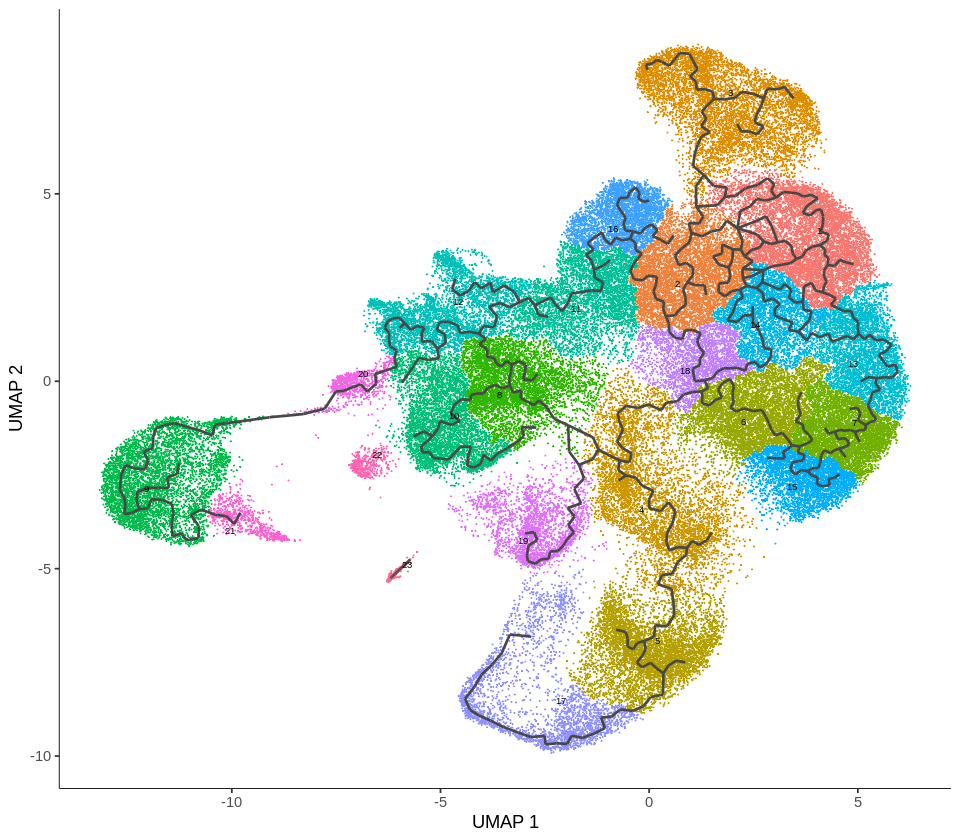

In [61]:
# cao.sub <- subset(as.Seurat(cds), monocle_partition == 1)
# cds@clusters$UMAP$partitions[cds@clusters$UMAP$partitions == "2"] <- "1"
# cds <- as.cell_data_set(cao.sub)

cds <- learn_graph(cds)
plot_cells(cds, label_groups_by_cluster = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

In [62]:
barcodes <- rownames(cao@meta.data[grep("24 - Lateral plate mesoderm", cao$CellTypeN),])

cds <- order_cells(cds, root_cells = barcodes)

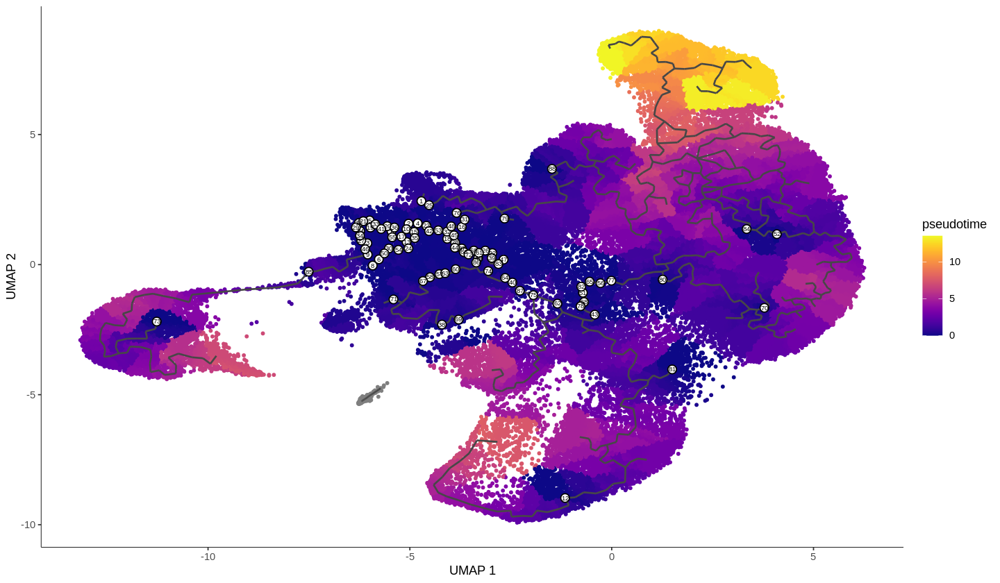

In [63]:
options(repr.plot.width = 12)
plot_cells(cds, color_cells_by = "pseudotime", label_cell_groups = FALSE, label_leaves = FALSE, 
    label_branch_points = FALSE, cell_size = 1)

In [64]:
names(colData(cds))

[1] "orig.ident"                "nCount_RNA"               
 [3] "nFeature_RNA"              "id"                       
 [5] "sex"                       "day"                      
 [7] "Total_mRNAs"               "tsne_1"                   
 [9] "tsne_2"                    "Main_Cluster"             
[11] "sub_tsne_1"                "sub_tsne_2"               
[13] "Sub_Cluster"               "db_score"                 
[15] "detected_doublet"          "potential_doublet_cluster"
[17] "percent.mito"              "S.Score"                  
[19] "G2M.Score"                 "Phase"                    
[21] "old.ident"                 "CC.Difference"            
[23] "RNA_snn_res.1.5"           "seurat_clusters"          
[25] "Annotation"                "labels"                   
[27] "Organism"                  "DevTP"                    
[29] "Dataset"                   "Tech"                     
[31] "Author"                    "CellType"                 
[33] "CellTypeN"                 "N"                        
[35] "ident"                     "Size_Factor"

In [65]:
cds@principal_graph_aux@listData$UMAP$pseudotime[which(!is.finite(cds@principal_graph_aux@listData$UMAP$pseudotime))] <- 15


In [66]:
cao.finished <- AddMetaData(
  object = cao,
  metadata = cds@principal_graph_aux@listData$UMAP$pseudotime,
  col.name = "monocle3_pseudotime"
)

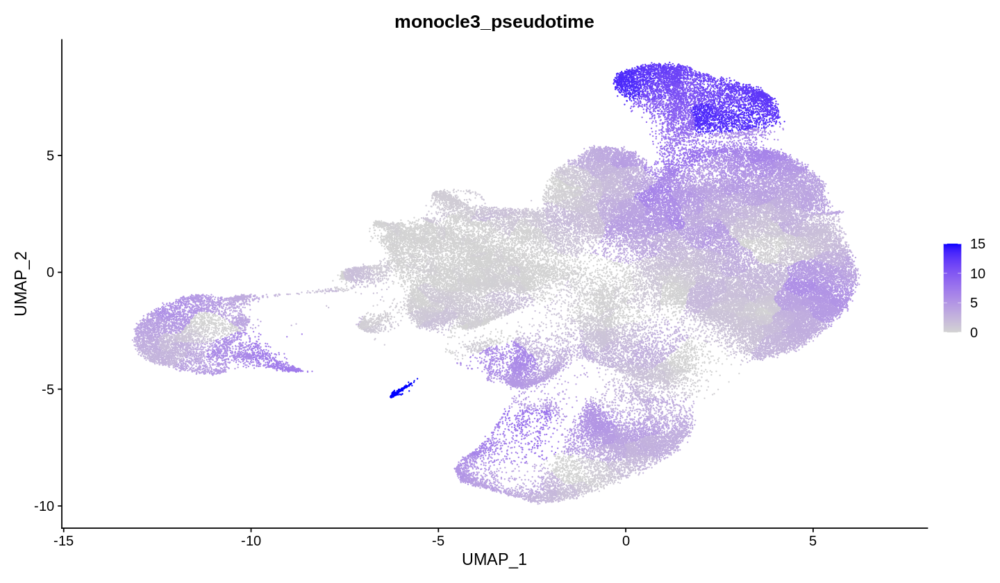

In [67]:
FeaturePlot(object = cao.finished, "monocle3_pseudotime")

In [68]:
saveRDS(cao.finished, "Full/RDataSessions/cao_with_monocle.Rds")

# Adult skeleton

In [37]:
object.list <- list(baryawno, adams)
object.list

[[1]]
An object of class Seurat 
27998 features across 24652 samples within 1 assay 
Active assay: RNA (27998 features, 2000 variable features)
 3 dimensional reductions calculated: pca, tsne, umap

[[2]]
An object of class Seurat 
16537 features across 27518 samples within 1 assay 
Active assay: RNA (16537 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap


In [38]:
object.list <- lapply(X = object.list, FUN = function(x) {
    x <- NormalizeData(x)
    x <- FindVariableFeatures(x, selection.method = "vst", nfeatures = 3000)
})

In [39]:
# select features that are repeatedly variable across datasets for integration run PCA on each
# dataset using these features
features <- SelectIntegrationFeatures(object.list = object.list)
object.list <- lapply(X = object.list, FUN = function(x) {
    x <- ScaleData(x, features = features, verbose = FALSE)
    x <- RunPCA(x, features = features, verbose = FALSE)
})

In [40]:
anchors <- FindIntegrationAnchors(object.list = object.list, anchor.features = features, reduction = "rpca", k.anchor = 20)

Scaling features for provided objects

Computing within dataset neighborhoods

Finding all pairwise anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 67750 anchors



In [41]:
skeleton.combined <- IntegrateData(anchorset = anchors)

Merging dataset 1 into 2

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



In [42]:
DefaultAssay(skeleton.combined) <- "integrated"

skeleton.combined <- ScaleData(skeleton.combined, verbose = FALSE)
skeleton.combined <- RunPCA(skeleton.combined, npcs = 30, verbose = FALSE)
skeleton.combined <- RunUMAP(skeleton.combined, reduction = "pca", dims = 1:30)
skeleton.combined <- FindNeighbors(skeleton.combined, reduction = "pca", dims = 1:30)
skeleton.combined <- FindClusters(skeleton.combined, resolution = 0.5)

19:19:38 UMAP embedding parameters a = 0.9922 b = 1.112

19:19:38 Read 52170 rows and found 30 numeric columns

19:19:38 Using Annoy for neighbor search, n_neighbors = 30

19:19:38 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

19:19:43 Writing NN index file to temp file /tmp/Rtmp5RP7dQ/file62021a0f40fb

19:19:43 Searching Annoy index using 1 thread, search_k = 3000

19:19:57 Annoy recall = 100%

19:19:57 Commencing smooth kNN distance calibration using 1 thread

19:19:59 Initializing from normalized Laplacian + noise

19:20:04 Commencing optimization for 200 epochs, with 2297424 positive edges

19:20:23 Optimization finished

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 52170
Number of edges: 2034894

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9438
Number of communities: 23
Elapsed time: 12 seconds


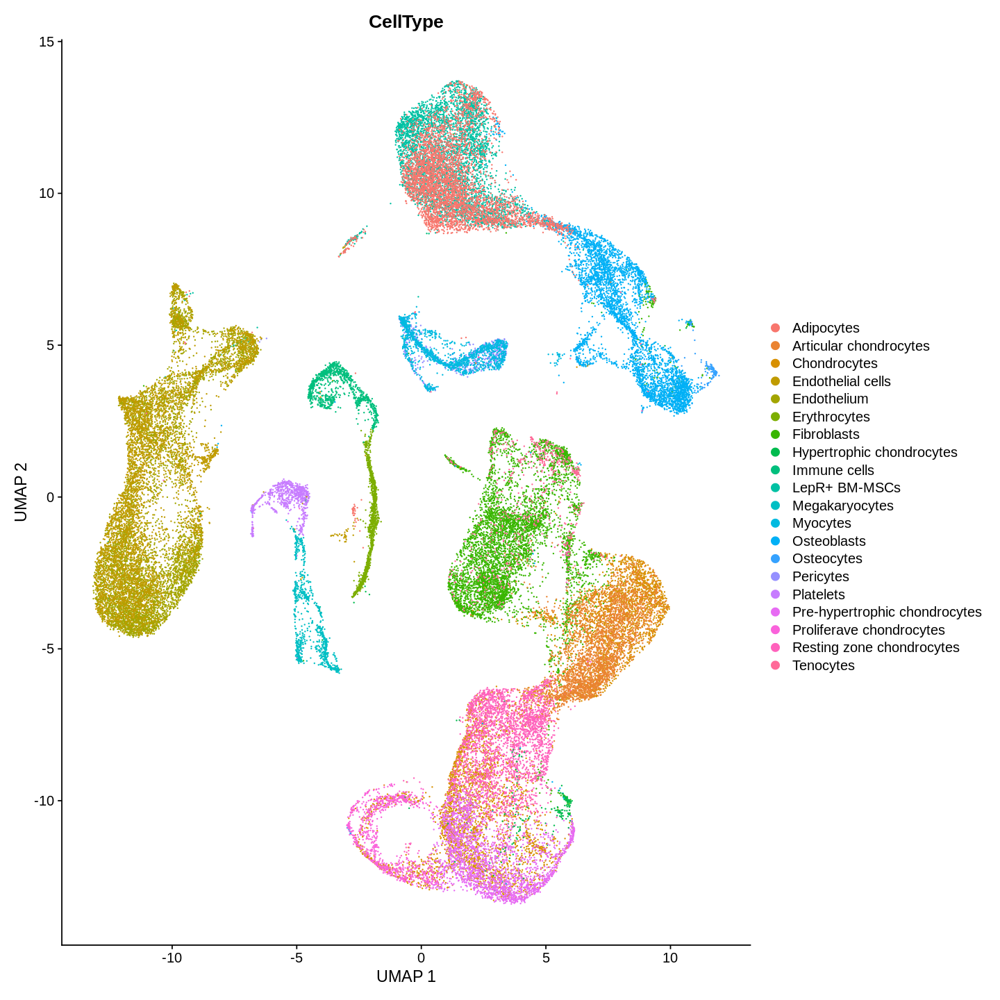

In [44]:
options(repr.plot.width=12, repr.plot.height=12)
p1 <- DimPlot(skeleton.combined, group.by = "CellType", label = FALSE, raster = FALSE,
              label.size = 6) + 
        xlab("UMAP 1") + ylab("UMAP 2")
p1

In [45]:
ggsave("./Full/Figures/SCA_V.0.5.0_adult-skeleton.png", width = 12, height = 12)

# Developing skeleton

In [34]:
object.list <- list(cao, chan, bohm, bian)
object.list

[[1]]
An object of class Seurat 
26183 features across 100000 samples within 1 assay 
Active assay: RNA (26183 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

[[2]]
An object of class Seurat 
27430 features across 682 samples within 2 assays 
Active assay: SCT (12597 features, 3000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, tsne

[[3]]
An object of class Seurat 
27343 features across 168 samples within 1 assay 
Active assay: RNA (27343 features, 2000 variable features)
 4 dimensional reductions calculated: PCA_coldata, pca, tsne, umap

[[4]]
An object of class Seurat 
16685 features across 11404 samples within 1 assay 
Active assay: RNA (16685 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, tsne


In [35]:
object.list <- lapply(X = object.list, FUN = function(x) {
    x <- NormalizeData(x)
    x <- FindVariableFeatures(x, selection.method = "vst", nfeatures = 3000)
})

In [36]:
# select features that are repeatedly variable across datasets for integration run PCA on each
# dataset using these features
features <- SelectIntegrationFeatures(object.list = object.list)
object.list <- lapply(X = object.list, FUN = function(x) {
    x <- ScaleData(x, features = features, verbose = FALSE)
    x <- RunPCA(x, features = features, verbose = FALSE)
})

In [37]:
anchors <- FindIntegrationAnchors(object.list = object.list, anchor.features = features, reduction = "rpca", k.anchor = 20)

Scaling features for provided objects

Computing within dataset neighborhoods

Finding all pairwise anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 2708 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 1408 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 1558 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 21928 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 4062 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 1933 anchors



In [38]:
skeleton.combined <- IntegrateData(anchorset = anchors)

Merging dataset 3 into 4

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 2 into 4 3

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 4 3 2 into 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



In [39]:
DefaultAssay(skeleton.combined) <- "integrated"

skeleton.combined <- ScaleData(skeleton.combined, verbose = FALSE)
skeleton.combined <- RunPCA(skeleton.combined, npcs = 30, verbose = FALSE)
skeleton.combined <- RunUMAP(skeleton.combined, reduction = "pca", dims = 1:30)
skeleton.combined <- FindNeighbors(skeleton.combined, reduction = "pca", dims = 1:30)
skeleton.combined <- FindClusters(skeleton.combined, resolution = 0.5)

14:44:16 UMAP embedding parameters a = 0.9922 b = 1.112

14:44:16 Read 112254 rows and found 30 numeric columns

14:44:16 Using Annoy for neighbor search, n_neighbors = 30

14:44:16 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:44:25 Writing NN index file to temp file /tmp/RtmpfmSGbw/file7fc2489df987

14:44:25 Searching Annoy index using 1 thread, search_k = 3000

14:45:08 Annoy recall = 100%

14:45:08 Commencing smooth kNN distance calibration using 1 thread

14:45:12 Initializing from normalized Laplacian + noise

14:45:18 Commencing optimization for 200 epochs, with 5165200 positive edges

14:46:18 Optimization finished

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 112254
Number of edges: 2910646

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8847
Number of communities: 22
Elapsed time: 40 seconds


6 singletons identified. 16 final clusters.



In [45]:
library(plyr)
skeleton.combined@meta.data$CellType <- revalue(skeleton.combined@meta.data$CellType, 
                                                c("Endothelial cells"="Endothelium",
                                                  "Sceletal muscle cells"="Skeletal muscle cells",
                                                  "Blood vessel endothelial cells"="Endothelium"))

The following `from` values were not present in `x`: Endothelial cells, Sceletal muscle cells



Warning message:
“ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


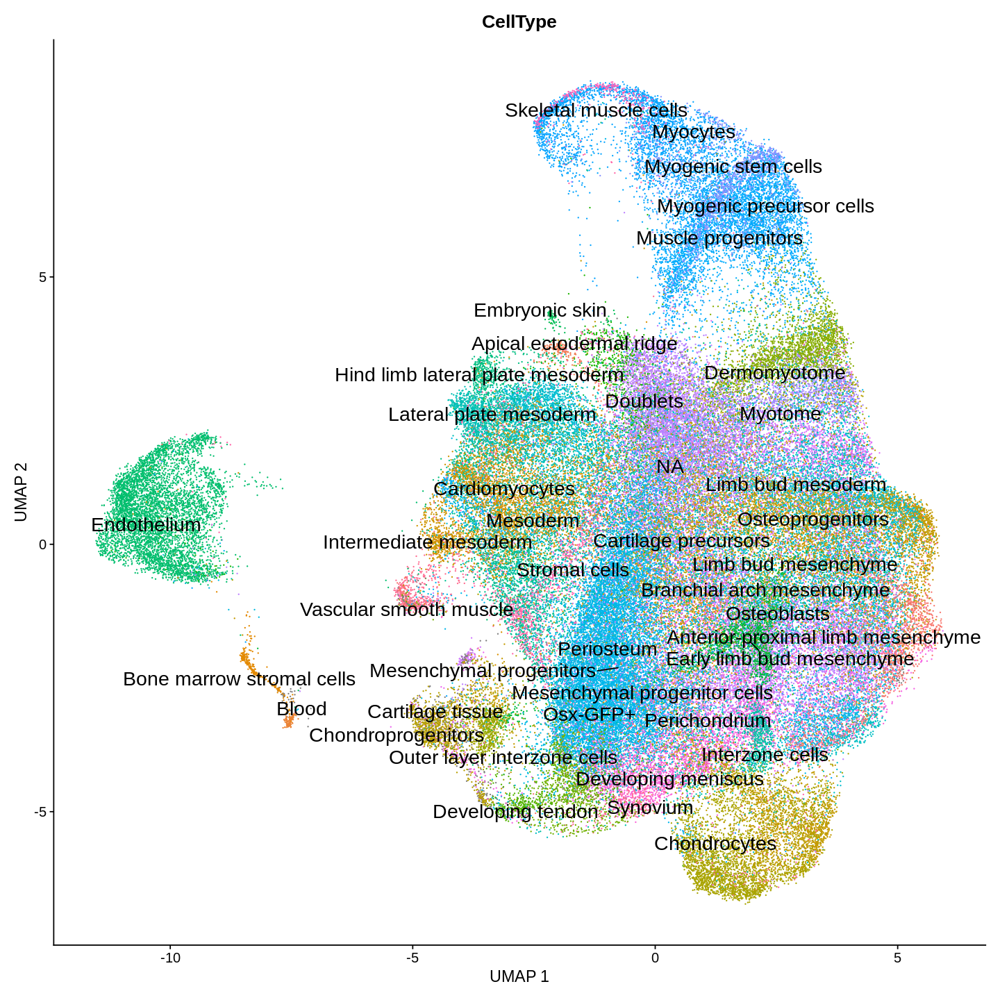

In [46]:
options(repr.plot.width=12, repr.plot.height=12)
p1 <- DimPlot(skeleton.combined, group.by = "CellType", label = TRUE, raster = FALSE, repel = T,
              label.size = 6) + NoLegend() + 
        xlab("UMAP 1") + ylab("UMAP 2")
p1

## Projecting Mizuhashi data for annotations

In [27]:
skeleton <- readRDS(file = "Full/RDataSessions/SCA_v.0.5.0.Rds")
skeleton

An object of class Seurat 
42632 features across 164230 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

In [248]:
mizuhashi <- readRDS(file = "Mizuhashi/Growthplate_NoriakiOno_seuratObject.Rds")
mizuhashi

An object of class Seurat 
16302 features across 7922 samples within 1 assay 
Active assay: RNA (16302 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 7922
Number of edges: 259273

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9418
Number of communities: 4
Elapsed time: 0 seconds


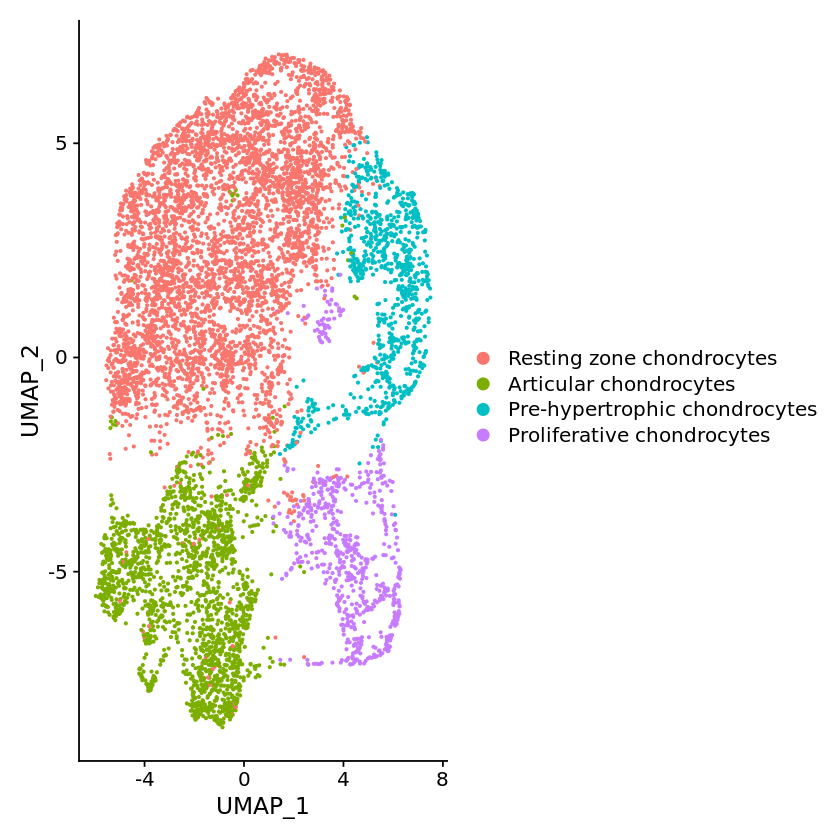

In [20]:
mizuhashi <- FindNeighbors(mizuhashi, dims = 1:20)
mizuhashi <- FindClusters(mizuhashi, resolution = 0.1)

new.cluster.ids <- c("Resting zone chondrocytes", "Articular chondrocytes", "Pre-hypertrophic chondrocytes", "Proliferative chondrocytes")
names(new.cluster.ids) <- levels(mizuhashi)
mizuhashi <- RenameIdents(mizuhashi, new.cluster.ids)
mizuhashi@meta.data$CellType = Idents(mizuhashi)
DimPlot(mizuhashi, reduction = "umap", pt.size = 0.5)

Seurat v4 also supports the projection of reference data (or meta data) onto a query object. While many of the methods are conserved (both procedures begin by identifying anchors), there are two important distinctions between data transfer and integration:

1. In data transfer, Seurat does not correct or modify the query expression data.
2. In data transfer, Seurat has an option (set by default) to project the PCA structure of a reference onto the query, instead of learning a joint structure with CCA. We generally suggest using this option when projecting data between scRNA-seq datasets.

After finding anchors, we use the `TransferData` function to classify the query cells based on reference data (a vector of reference cell type labels). TransferData returns a matrix with predicted IDs and prediction scores, which we can add to the query metadata.

In [30]:
data.list <- list(skeleton, mizuhashi)
data.list

[[1]]
An object of class Seurat 
42632 features across 164230 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

[[2]]
An object of class Seurat 
16302 features across 7922 samples within 1 assay 
Active assay: RNA (16302 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap


In [13]:
data.anchors <- FindTransferAnchors(reference = skeleton, query = mizuhashi, dims = 1:30)
predictions <- TransferData(anchorset = data.anchors, refdata = skeleton$CellType, dims = 1:30)
mizuhashi <- AddMetaData(mizuhashi, metadata = predictions)

Performing PCA on the provided reference using 1837 features as input.

Projecting cell embeddings

Finding neighborhoods

Finding anchors

	Found 1087 anchors

Filtering anchors

	Retained 437 anchors

Finding integration vectors

Finding integration vector weights

Predicting cell labels



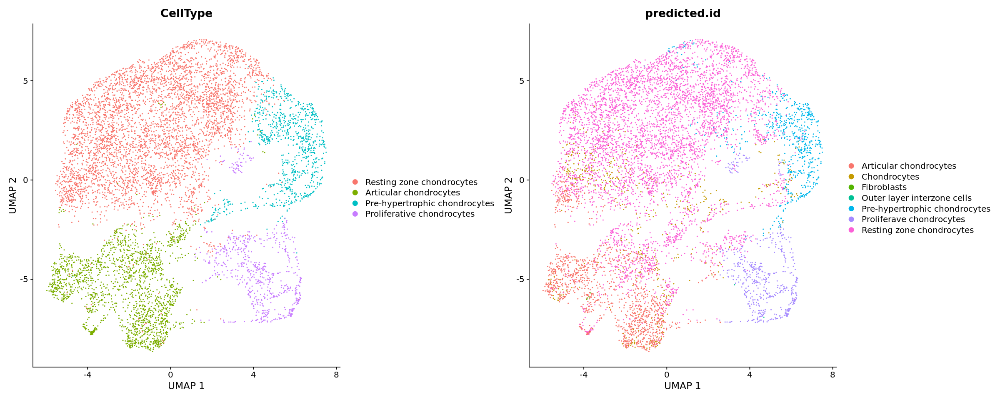

In [16]:
options(repr.plot.width = 20, repr.plot.height = 8)

p1 <- DimPlot(mizuhashi, group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2") 
p2 <- DimPlot(mizuhashi, group.by = "predicted.id") + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

In [19]:
ggsave("./Full/Figures/Mizuhashi_autoAnnotation.png", width = 20, height = 8)

### Evaluate agreeance between automated and manual annotation

In [17]:
mizuhashi$prediction.match <- mizuhashi$predicted.id == mizuhashi$CellType
table(mizuhashi$prediction.match)


FALSE  TRUE 
 2177  5745 

In [18]:
5745/(2177+5745)

[1] 0.7251957

## Spheroid projection

In [3]:
spheroid <- readRDS(file = "../spheroids/single-cell/RDatasessions/spheroids_seuratobject.Rds")
spheroid

An object of class Seurat 
15680 features across 12544 samples within 1 assay 
Active assay: RNA (15680 features, 2000 variable features)
 3 dimensional reductions calculated: PCA_coldata, pca, umap

In [4]:
spheroid$Timepoint <- relevel(spheroid$Timepoint, ref = "H5")

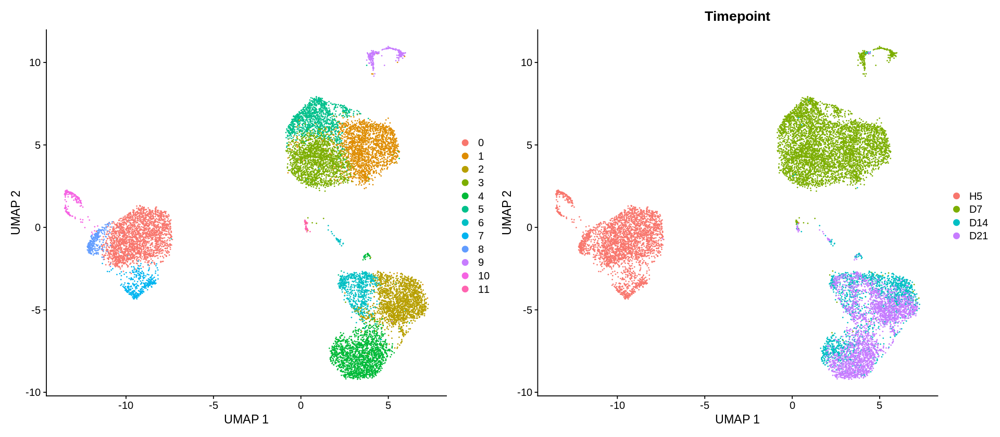

In [5]:
options(repr.plot.width = 16, repr.plot.height = 7)

p1 <- DimPlot(spheroid) + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- DimPlot(spheroid, group.by = "Timepoint") + xlab("UMAP 1") + ylab("UMAP 2") 

p1 + p2

In [6]:
library(stringr)

In [7]:
lowercase <- tolower(rownames(spheroid))
mgi <- str_to_title(lowercase)
head(mgi)

[1] "Samd11"  "Noc2l"   "Klhl17"  "Plekhn1" "Perm1"   "Hes4"

In [9]:
mgi <- as.data.frame(mgi)
head(mgi)

,mgi
,<chr>
1,Samd11
2,Noc2l
3,Klhl17
4,Plekhn1
5,Perm1
6,Hes4


In [22]:
data.list <- list(skeleton.combined, spheroid)
data.list

[[1]]
An object of class Seurat 
71392 features across 150800 samples within 3 assays 
Active assay: RNA (42049 features, 2000 variable features)
 2 other assays present: originalexp, integrated
 2 dimensional reductions calculated: pca, umap

[[2]]
An object of class Seurat 
15680 features across 12544 samples within 1 assay 
Active assay: RNA (15680 features, 2000 variable features)
 3 dimensional reductions calculated: PCA_coldata, pca, umap


In [ ]:
if (!require("BiocManager", quietly = TRUE))
    install.packages("BiocManager")

BiocManager::install("biomaRt")

'getOption("repos")' replaces Bioconductor standard repositories, see
'?repositories' for details

replacement repositories:
    CRAN: https://cran.r-project.org


Bioconductor version 3.14 (BiocManager 1.30.16), R 4.1.2 (2021-11-01)

Installing package(s) 'biomaRt'

also installing the dependencies ‘filelock’, ‘BiocFileCache’


Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Old packages: 'ape', 'BiocParallel', 'caret', 'commonmark', 'desc', 'DT',
  'fitdistrplus', 'GenomeInfoDb', 'GenomicRanges', 'git2r', 'glue', 'gmp',
  'jsonlite', 'latex2exp', 'leidenbase', 'limma', 'locfit', 'maptools', 'mgcv',
  'openssl', 'pracma', 'Rcpp', 'rhdf5', 'rlang', 'rmarkdown', 'S4Vectors',
  'sf', 'speedglm', 'survival', 'uuid', 'waldo', 'withr', 'xfun', 'XML'



In [13]:
convertHumanGeneList <- function(x){

   library("biomaRt")
   human <- useMart("ensembl", dataset = "hsapiens_gene_ensembl")
   mouse <- useMart("ensembl", dataset = "mmusculus_gene_ensembl")

   genesV2 <- getLDS(attributes = c("hgnc_symbol"), filters = "hgnc_symbol", 
                 values = x , mart = human, attributesL = c("mgi_symbol"), martL = mouse, uniqueRows=T)

   humanx <- unique(genesV2[, 2])

   return(humanx)
}

In [11]:
spheroid@assays$RNA@counts@Dimnames[[1]] <- mgi$mgi
spheroid@assays$RNA@data@Dimnames[[1]] <- mgi$mgi
spheroid@assays$RNA@meta.features <- mgi

In [12]:
head(rownames(spheroid))

[1] "Samd11"  "Noc2l"   "Klhl17"  "Plekhn1" "Perm1"   "Hes4"

In [13]:
data.anchors <- FindTransferAnchors(reference = skeleton.combined, query = spheroid, dims = 1:30)
predictions <- TransferData(anchorset = data.anchors, refdata = skeleton.combined$CellType, dims = 1:30)
spheroid <- AddMetaData(spheroid, metadata = predictions)

Performing PCA on the provided reference using 1754 features as input.

Projecting cell embeddings

Finding neighborhoods

Finding anchors

	Found 358 anchors

Filtering anchors

	Retained 92 anchors

Finding integration vectors

Finding integration vector weights

Predicting cell labels



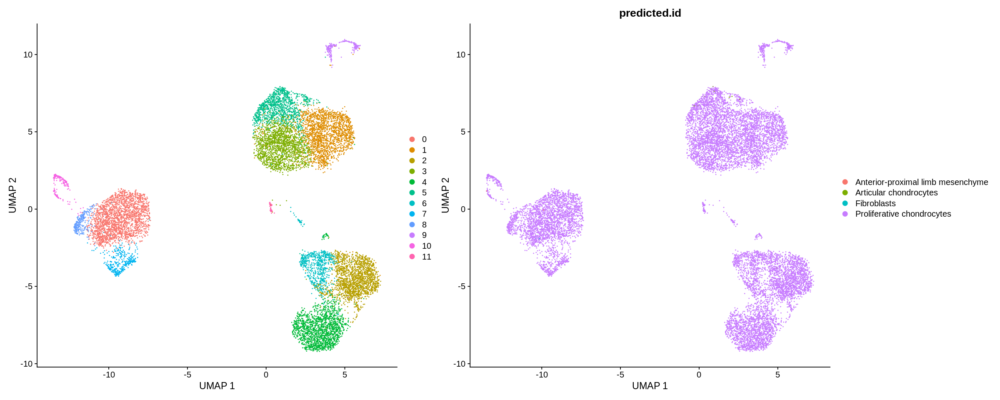

In [14]:
options(repr.plot.width = 20, repr.plot.height = 8)

p1 <- DimPlot(spheroid) + xlab("UMAP 1") + ylab("UMAP 2") 
p2 <- DimPlot(spheroid, group.by = "predicted.id") + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

## Integrate into atlas

In [31]:
# select features that are repeatedly variable across datasets for integration run PCA on each
# dataset using these features
features <- SelectIntegrationFeatures(object.list = data.list)
data.list <- lapply(X = data.list, FUN = function(x) {
    x <- ScaleData(x, features = features, verbose = FALSE)
    x <- RunPCA(x, features = features, verbose = FALSE)
})

In [32]:
anchors <- FindIntegrationAnchors(object.list = data.list, anchor.features = features, reduction = "rpca", k.anchor = 20)

Scaling features for provided objects

Computing within dataset neighborhoods

Finding all pairwise anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 13999 anchors



In [33]:
skeleton.combined <- IntegrateData(anchorset = anchors)

Merging dataset 2 into 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



In [ ]:
DefaultAssay(skeleton.combined) <- "integrated"

skeleton.combined <- ScaleData(skeleton.combined, verbose = FALSE)
skeleton.combined <- RunPCA(skeleton.combined, npcs = 30, verbose = FALSE)
skeleton.combined <- RunUMAP(skeleton.combined, reduction = "pca", dims = 1:30)
skeleton.combined <- FindNeighbors(skeleton.combined, reduction = "pca", dims = 1:30)
skeleton.combined <- FindClusters(skeleton.combined, resolution = 0.5)

15:09:04 UMAP embedding parameters a = 0.9922 b = 1.112

15:09:04 Read 172152 rows and found 30 numeric columns

15:09:04 Using Annoy for neighbor search, n_neighbors = 30

15:09:04 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:09:21 Writing NN index file to temp file /tmp/Rtmp3PTjtN/file3714a3d226b

15:09:22 Searching Annoy index using 1 thread, search_k = 3000

15:10:23 Annoy recall = 100%

15:10:24 Commencing smooth kNN distance calibration using 1 thread

15:10:30 Initializing from normalized Laplacian + noise

15:10:50 Commencing optimization for 200 epochs, with 8031030 positive edges

15:12:30 Optimization finished

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 172152
Number of edges: 5011405

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9174
Number of communities: 34
Elapsed time: 155 seconds


11 singletons identified. 23 final clusters.



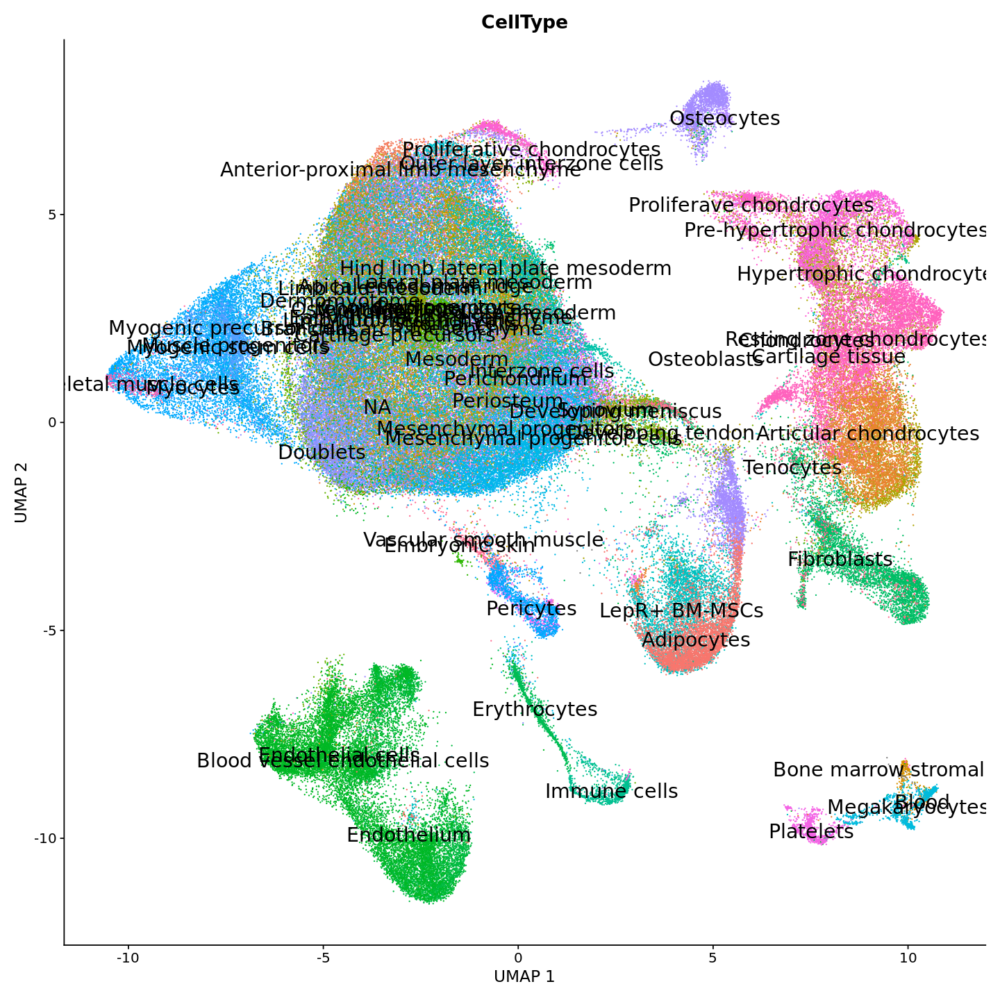

In [ ]:
options(repr.plot.width=12, repr.plot.height=12)
p1 <- DimPlot(skeleton.combined, group.by = "CellType", label = TRUE, raster = FALSE,
              label.size = 6) + 
        xlab("UMAP 1") + ylab("UMAP 2") + NoLegend()
p1

In [55]:
saveRDS(skeleton.combined, file = "Full/RDataSessions/SCA_v.0.5.1.Rds")

## Bohm data

In [249]:
he <- readRDS(file = "ENCODE/scRNA-seq/10x/mouse_forelimb_seuratobject2.Rds")
he

An object of class Seurat 
24662 features across 136418 samples within 1 assay 
Active assay: RNA (24662 features, 2000 variable features)
 3 dimensional reductions calculated: pca, umap, FItSNE

In [250]:
skeletal.list <- list(bohm, li, he, mizuhashi)

In [240]:
skeletal.list <- lapply(X =skeletal.list, FUN = function(x) {
    x <- NormalizeData(x, verbose = FALSE)
    x <- FindVariableFeatures(x, verbose = FALSE)
})

In [241]:
features <- SelectIntegrationFeatures(object.list = skeletal.list)
skeletal.list <- lapply(X = skeletal.list, FUN = function(x) {
    x <- ScaleData(x, features = features, verbose = FALSE)
    x <- RunPCA(x, features = features, verbose = FALSE)
})

Warning message:
“Cannot add objects with duplicate keys (offending key: PC_) setting key to original value 'pca_'”


In [242]:
anchors <- FindIntegrationAnchors(object.list = skeletal.list, reference = c(1), reduction = "rpca", 
    dims = 1:30)
skeleton.integrated <- IntegrateData(anchorset = anchors, dims = 1:30)

Computing 2000 integration features

Scaling features for provided objects

Computing within dataset neighborhoods

Finding anchors between all query and reference datasets

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 330 anchors

Merging dataset 2 into 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



In [243]:
skeleton.integrated <- ScaleData(skeleton.integrated, verbose = FALSE)
skeleton.integrated <- RunPCA(skeleton.integrated, verbose = FALSE)
skeleton.integrated <- RunUMAP(skeleton.integrated, dims = 1:30)

06:05:33 UMAP embedding parameters a = 0.9922 b = 1.112

06:05:33 Read 150614 rows and found 30 numeric columns

06:05:33 Using Annoy for neighbor search, n_neighbors = 30

06:05:33 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

06:05:49 Writing NN index file to temp file /tmp/RtmpMglUuR/file9e7ee01fca

06:05:49 Searching Annoy index using 1 thread, search_k = 3000

06:06:42 Annoy recall = 100%

06:06:44 Commencing smooth kNN distance calibration using 1 thread

06:06:51 Initializing from normalized Laplacian + noise

06:07:03 Commencing optimization for 200 epochs, with 7026268 positive edges

06:08:21 Optimization finished



Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



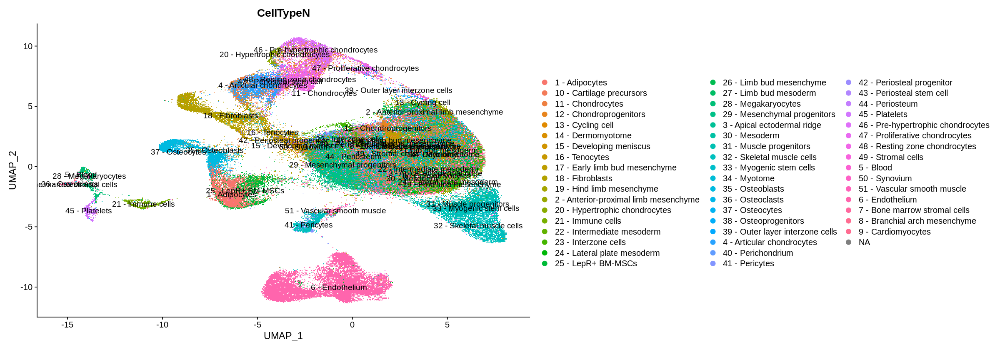

In [247]:
options(repr.plot.width=20)
DimPlot(skeleton.integrated, group.by  = "CellTypeN", label = T)

## Growth plate

In [59]:
skeleton <- readRDS(file = "Full/RDataSessions/SCA_v.0.5.1.Rds")
skeleton

An object of class Seurat 
55487 features across 151260 samples within 3 assays 
Active assay: integrated (2000 features, 2000 variable features)
 2 other assays present: RNA, SCT
 2 dimensional reductions calculated: pca, umap

In [60]:
skeleton.combined$CellType <- as.factor(skeleton.combined$CellType)

# skeleton.combined$CellType <- revalue(skeleton.combined$CellType, c("Proliferave chondrocytes" = "Proliferative chondrocytes"))

The following `from` values were not present in `x`: Proliferave chondrocytes



In [258]:
# chondro.1 <- grep("Resting zone chondrocytes", skeleton$CellType)
chondro.2 <- grep("Proliferative chondrocytes", skeleton.combined$CellType)
chondro.3 <- grep("Pre-hypertrophic chondrocytes", skeleton.combined$CellType)
chondro.4 <- grep("Hypertrophic chondrocytes", skeleton.combined$CellType)
# chondro.5 <- grep("Articular chondrocytes", skeleton$CellType)

gp.chondrocytes <- c(chondro.2, chondro.3, chondro.4)

In [260]:
barcodes <- rownames(skeleton.combined@meta.data[gp.chondrocytes,])

### subset SeuratObject on GP chondrocyte barcodes

In [262]:
gp <- subset(skeleton.combined, cells = barcodes)
gp

An object of class Seurat 
42632 features across 3474 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

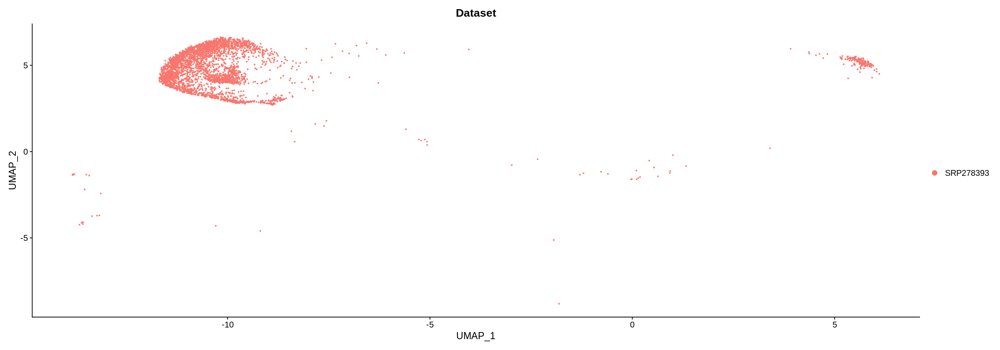

In [263]:
DimPlot(gp, group.by = "Dataset")

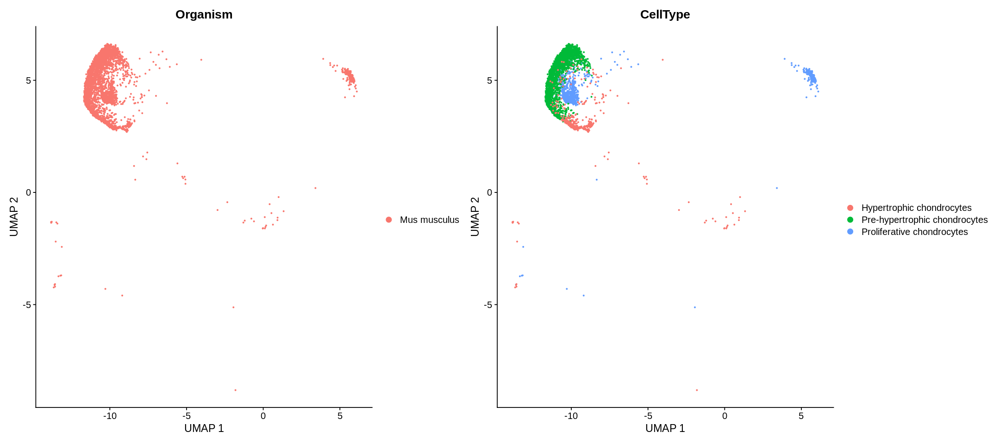

In [264]:
options(repr.plot.width = 18, repr.plot.height = 8)
p1 <- DimPlot(gp, group.by = "Organism") + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- DimPlot(gp, group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

In [265]:
gp <- ScaleData(gp)

Centering and scaling data matrix



In [266]:
gp <- RunUMAP(gp, dims = 1:20, min.dist = .5, local.connectivity = 1.5)

07:11:20 UMAP embedding parameters a = 0.583 b = 1.334

07:11:20 Read 3474 rows and found 20 numeric columns

07:11:20 Using Annoy for neighbor search, n_neighbors = 30

07:11:20 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

07:11:20 Writing NN index file to temp file /tmp/RtmpMglUuR/file9e7469cb6e6

07:11:20 Searching Annoy index using 1 thread, search_k = 3000

07:11:21 Annoy recall = 100%

07:11:25 Commencing smooth kNN distance calibration using 1 thread

07:11:27 Initializing from normalized Laplacian + noise

07:11:27 Commencing optimization for 500 epochs, with 147462 positive edges

07:11:32 Optimization finished



In [269]:
levels(gp$CellType)

[1] "Adipocytes"                        "Anterior-proximal limb mesenchyme"
 [3] "Apical ectodermal ridge"           "Articular chondrocytes"           
 [5] "Blood"                             "Endothelium"                      
 [7] "Bone marrow stromal cells"         "Branchial arch mesenchyme"        
 [9] "Cardiomyocytes"                    "Cartilage precursors"             
[11] "Chondrocytes"                      "Chondroprogenitors"               
[13] "Cycling cell"                      "Dermomyotome"                     
[15] "Developing meniscus"               "Tenocytes"                        
[17] "Early limb bud mesenchyme"         "Fibroblasts"                      
[19] "Hind limb mesenchyme"              "Hypertrophic chondrocytes"        
[21] "Immune cells"                      "Intermediate mesoderm"            
[23] "Interzone cells"                   "Lateral plate mesoderm"           
[25] "LepR+ BM-MSCs"                     "Limb bud mesenchyme"              
[27] "Limb bud mesoderm"                 "Megakaryocytes"                   
[29] "Mesenchymal progenitors"           "Mesoderm"                         
[31] "Muscle progenitors"                "Skeletal muscle cells"            
[33] "Myogenic stem cells"               "Myotome"                          
[35] "Osteoblasts"                       "Osteoclasts"                      
[37] "Osteocytes"                        "Osteoprogenitors"                 
[39] "Outer layer interzone cells"       "Perichondrium"                    
[41] "Pericytes"                         "Periosteal progenitor"            
[43] "Periosteal stem cell"              "Periosteum"                       
[45] "Platelets"                         "Pre-hypertrophic chondrocytes"    
[47] "Proliferative chondrocytes"        "Resting zone chondrocytes"        
[49] "Stromal cells"                     "Synovium"                         
[51] "Vascular smooth muscle"

In [270]:
gp$CellType <- factor(gp$CellType, levels = c("Hypertrophic chondrocytes", "Proliferative chondrocytes", "Pre-hypertrophic chondrocytes"))

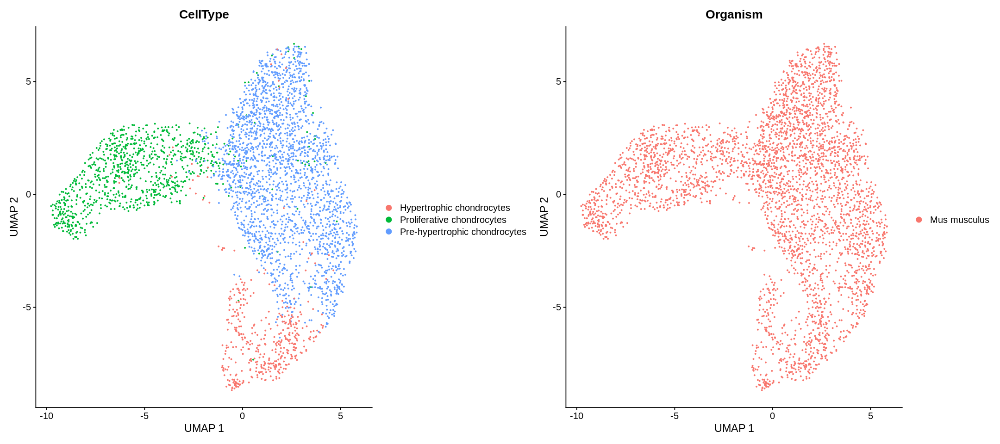

In [271]:
options(repr.plot.width = 18, repr.plot.height = 8)
p1 <- DimPlot(gp, group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- DimPlot(gp, group.by = "Organism") + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2

## Monocle3 pseudotime analysis
### Load the data

In [278]:
gp <- readRDS(file = "./Full/RDataSessions/growth_plate_seurat.Rds")
gp

An object of class Seurat 
42515 features across 4999 samples within 2 assays 
Active assay: integrated (1837 features, 1837 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, umap

### Convert to celldataset

In [ ]:
cds <- as.cell_data_set(gp, assay = NULL)
cds <- cluster_cells(cds)
p1 <- plot_cells(cds, show_trajectory_graph = FALSE)
p2 <- plot_cells(cds, color_cells_by = "partition", show_trajectory_graph = FALSE)

In [ ]:
p1 + p2

  |======================================================================| 100%


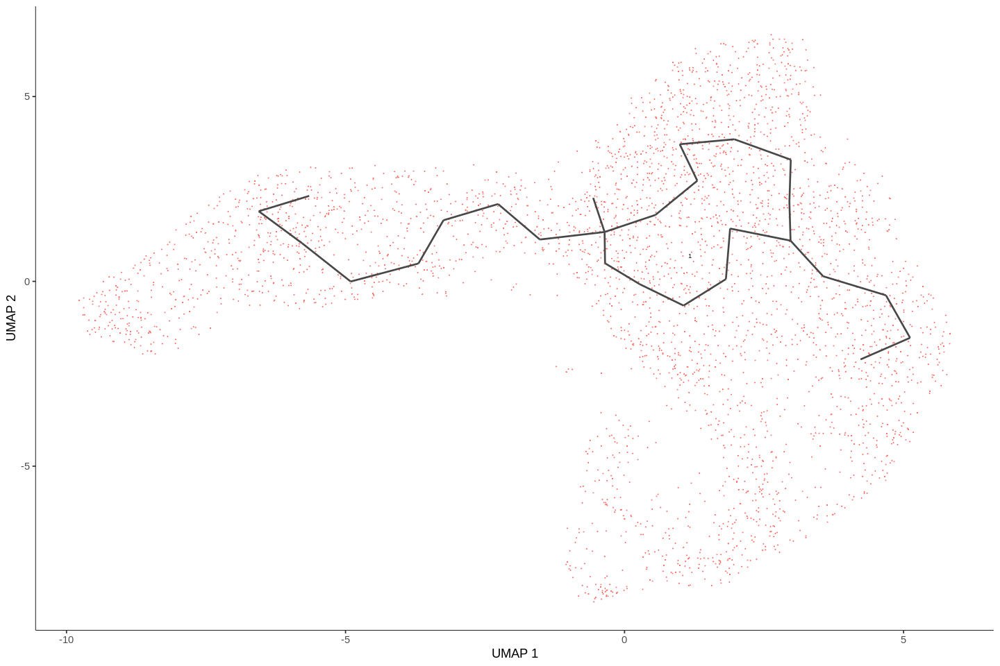

In [279]:
# gp.sub <- subset(as.Seurat(cds), monocle3_partitions == 1)
# cds@clusters$UMAP$partitions[cds@clusters$UMAP$partitions == "2"] <- "1"
# cds <- as.cell_data_set(gp)

cds <- learn_graph(cds)
plot_cells(cds, label_groups_by_cluster = FALSE, label_leaves = FALSE, label_branch_points = FALSE)

In [285]:
barcodes <- head(rownames(gp@meta.data[grep("Proliferative chondrocytes", gp$CellType),]))

cds <- order_cells(cds, root_cells = barcodes)

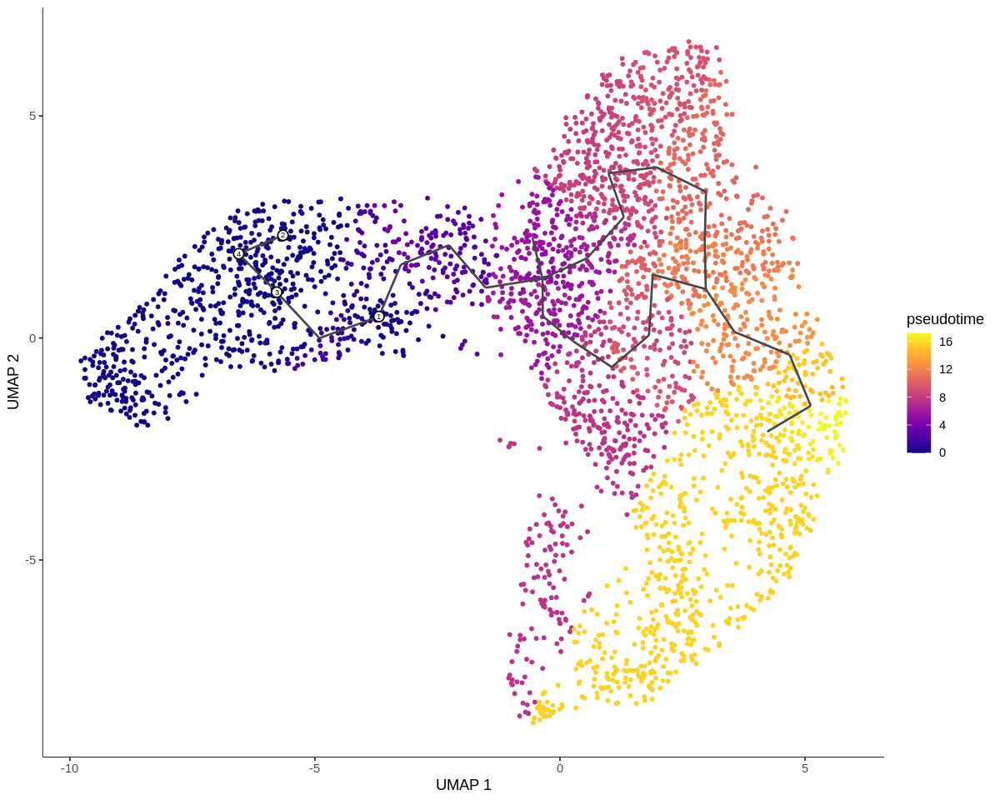

In [300]:
options(repr.plot.width = 10)
plot_cells(cds, color_cells_by = "pseudotime", label_cell_groups = FALSE, label_leaves = FALSE, 
    label_branch_points = FALSE, cell_size = 1)

In [301]:
ggsave("./Full/output/gp_pseudotime.png", dpi = 300, width = 10)

Saving 10 x 6.67 in image



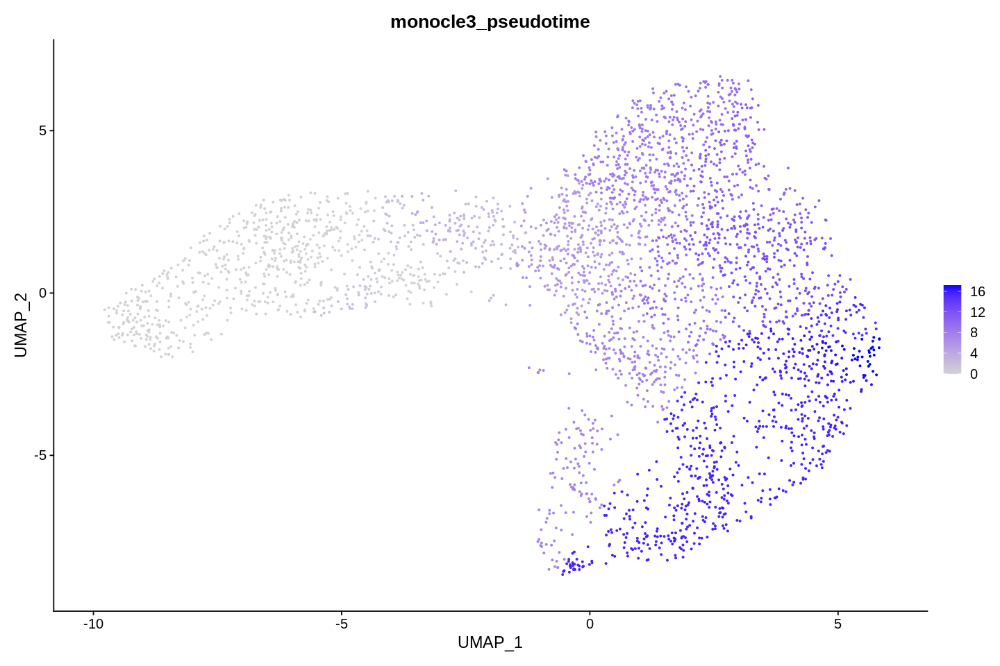

In [287]:
gp.finished <- as.Seurat(cds)
FeaturePlot(gp.finished, "monocle3_pseudotime")

In [288]:
rowData(cds)$gene_short_name <- rownames(rowData(cds))

In [289]:
genes = rownames(gp.finished)
gp.finished <- ScaleData(gp.finished, features = genes)
gp.finished <- RunPCA(gp.finished, features = genes, verbose = FALSE)

Centering and scaling data matrix



In [290]:
gp.finished

An object of class Seurat 
42632 features across 3474 samples within 2 assays 
Active assay: RNA (40632 features, 0 variable features)
 1 other assay present: integrated
 2 dimensional reductions calculated: UMAP, pca

In [291]:
saveRDS(gp.finished, file = "./Full/RDataSessions/growth_plate_seurat+monocle.Rds")

In [8]:
gp.finished <- readRDS(file = "./Full/RDataSessions/growth_plate_seurat+monocle.Rds")
gp.finished

An object of class Seurat 
42515 features across 4999 samples within 2 assays 
Active assay: RNA (40678 features, 0 variable features)
 1 other assay present: integrated
 3 dimensional reductions calculated: UMAP, pca, umap_3d

In [292]:
gp.finished$CellType <- factor(gp.finished$CellType, 
                               levels = c("Hypertrophic chondrocytes", "Proliferative chondrocytes", "Pre-hypertrophic chondrocytes"))

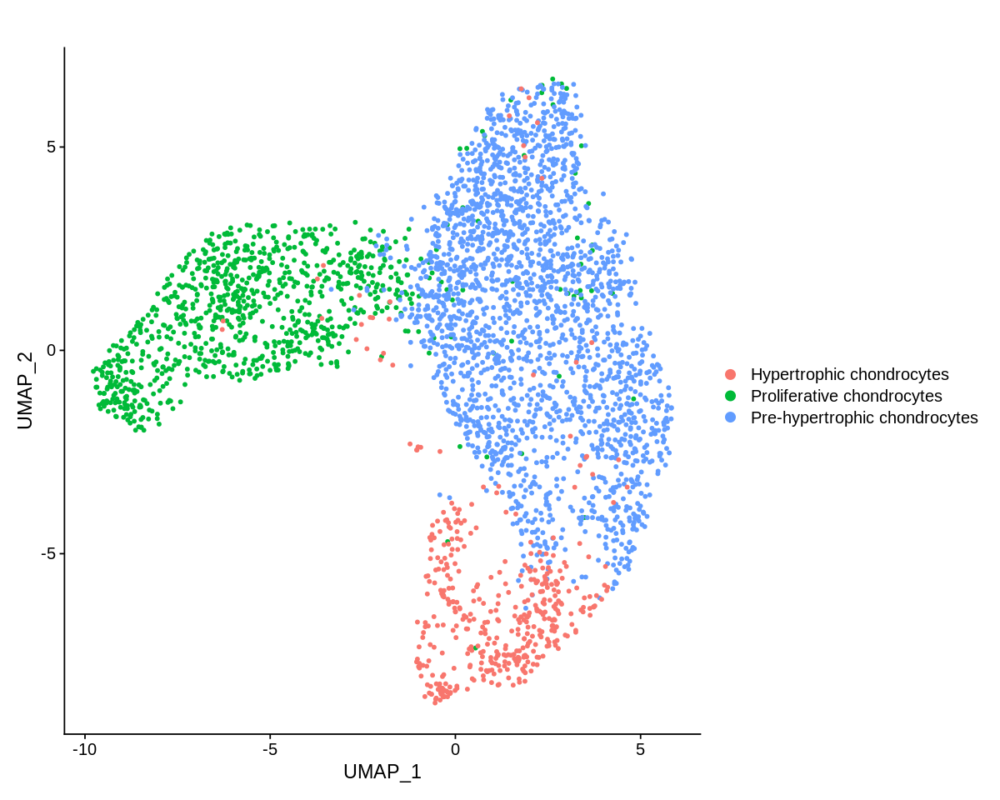

In [293]:
options(repr.plot.width=10)
DimPlot(gp.finished, group.by = "CellType", reduction = "UMAP", pt.size = 1) + ggtitle("") 

In [294]:
ggsave("Full/output/gp_clusters.png", dpi = 300, width = 10)

Saving 10 x 6.67 in image



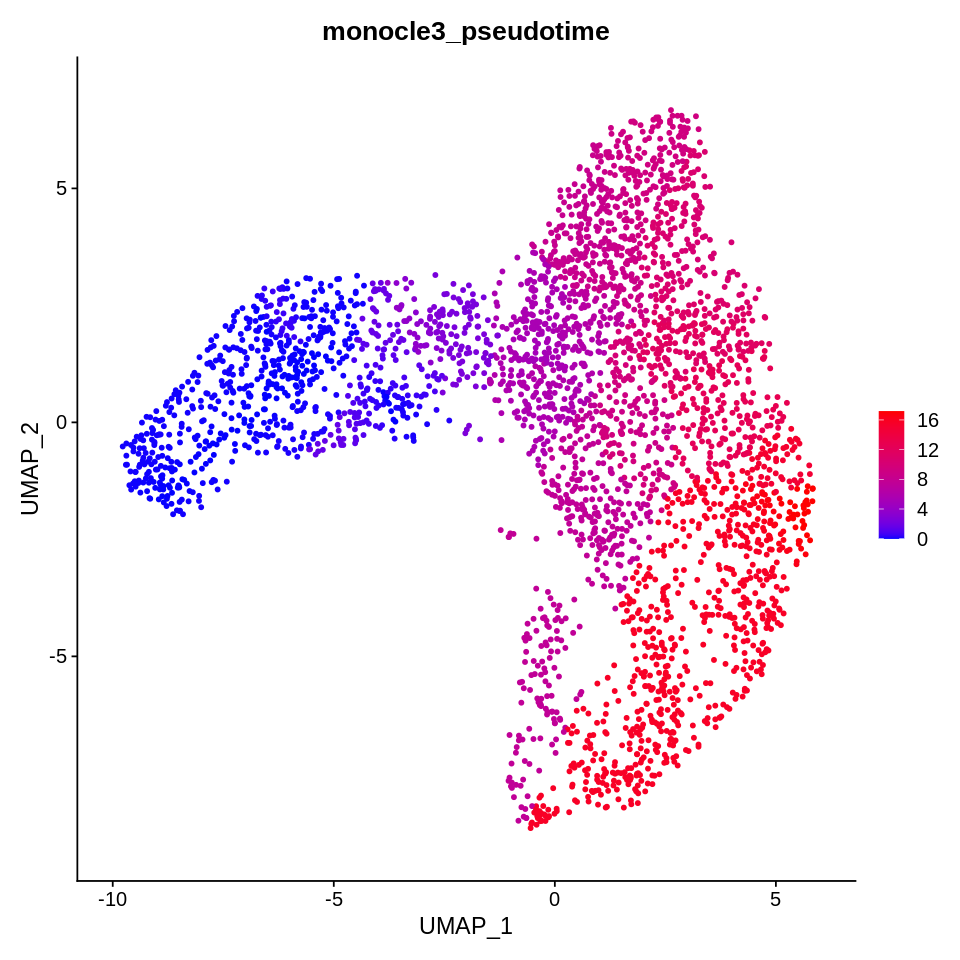

In [295]:
options(repr.plot.width = 8)
FeaturePlot(gp.finished, "monocle3_pseudotime",cols = c("#0000FF","#ff0000"), reduction = "UMAP", pt.size = 1)

In [4]:
gp.finished <- RunUMAP(gp.finished, dims = 1:20, min.dist = .5, local.connectivity = 1.5, n.components = 3L, reduction.name = "umap_3d")

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
15:16:29 UMAP embedding parameters a = 0.583 b = 1.334

15:16:29 Read 4999 rows and found 20 numeric columns

15:16:29 Using Annoy for neighbor search, n_neighbors = 30

15:16:29 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:16:30 Writing NN index file to temp file /tmp/Rtmp49Zd7m/file23b337d55ba

15:16:30 Searching Annoy index using 1 thread, search_k = 3000

15:16:31 Annoy recall = 100%

15:16:31 Commencing smooth kNN distance calibration using 1 thread

15:16:32 Initializing from 

In [5]:
saveRDS(gp.finished, file = "./Full/RDataSessions/growth_plate_seurat+monocle.Rds")

In [50]:
mizuhashi$dataset <- "SRP181191"

In [51]:
object.list <- list(chan, adams, li, bohm, mizuhashi)
object.list

[[1]]
An object of class Seurat 
27430 features across 682 samples within 2 assays 
Active assay: SCT (12597 features, 3000 variable features)
 1 other assay present: RNA
 2 dimensional reductions calculated: pca, tsne

[[2]]
An object of class Seurat 
16537 features across 27518 samples within 1 assay 
Active assay: RNA (16537 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

[[3]]
An object of class Seurat 
22893 features across 186 samples within 1 assay 
Active assay: RNA (22893 features, 2000 variable features)
 3 dimensional reductions calculated: PCA_coldata, pca, tsne

[[4]]
An object of class Seurat 
27343 features across 168 samples within 1 assay 
Active assay: RNA (27343 features, 2000 variable features)
 4 dimensional reductions calculated: PCA_coldata, pca, tsne, umap

[[5]]
An object of class Seurat 
16302 features across 7922 samples within 1 assay 
Active assay: RNA (16302 features, 2000 variable features)
 2 dimensional reductions calc

In [53]:
object.list <- lapply(X = object.list, FUN = function(x){
    x <- RunUMAP(x, dims = 1:20)
})
object.list

16:10:32 UMAP embedding parameters a = 0.9922 b = 1.112

16:10:32 Read 682 rows and found 20 numeric columns

16:10:32 Using Annoy for neighbor search, n_neighbors = 30

16:10:32 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:10:33 Writing NN index file to temp file /tmp/Rtmp4SjTjh/file23ac14370c

16:10:33 Searching Annoy index using 1 thread, search_k = 3000

16:10:33 Annoy recall = 100%

16:10:33 Commencing smooth kNN distance calibration using 1 thread

16:10:35 Initializing from normalized Laplacian + noise

16:10:35 Commencing optimization for 500 epochs, with 25856 positive edges

16:10:36 Optimization finished

16:10:36 UMAP embedding parameters a = 0.9922 b = 1.112

16:10:36 Read 27518 rows and found 20 numeric columns

16:10:36 Using Annoy for neighbor sea

[[1]]
An object of class Seurat 
27430 features across 682 samples within 2 assays 
Active assay: SCT (12597 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, tsne, umap

[[2]]
An object of class Seurat 
16537 features across 27518 samples within 1 assay 
Active assay: RNA (16537 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

[[3]]
An object of class Seurat 
22893 features across 186 samples within 1 assay 
Active assay: RNA (22893 features, 2000 variable features)
 4 dimensional reductions calculated: PCA_coldata, pca, tsne, umap

[[4]]
An object of class Seurat 
27343 features across 168 samples within 1 assay 
Active assay: RNA (27343 features, 2000 variable features)
 4 dimensional reductions calculated: PCA_coldata, pca, tsne, umap

[[5]]
An object of class Seurat 
16302 features across 7922 samples within 1 assay 
Active assay: RNA (16302 features, 2000 variable features)
 2 dimensional red

In [64]:
for (i in 1:10){
    print(i)
}

[1] 1
[1] 2
[1] 3
[1] 4
[1] 5
[1] 6
[1] 7
[1] 8
[1] 9
[1] 10


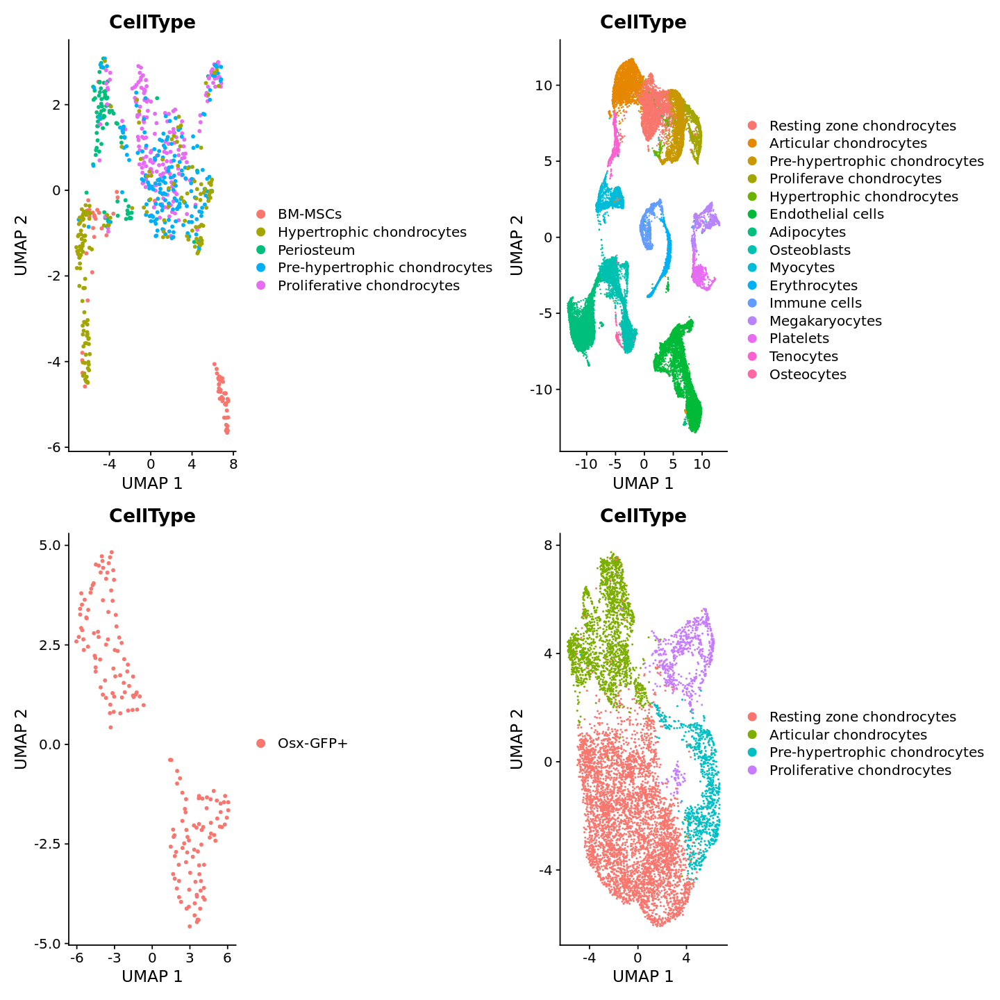

In [68]:
p1 <- DimPlot(object.list[[1]], group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- DimPlot(object.list[[2]], group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2")
# p3 <- DimPlot(object.list[[3]], group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2")
p4 <- DimPlot(object.list[[4]], group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2")
p5 <- DimPlot(object.list[[5]], group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2")

p1 + p2  + p4 + p5 +
    plot_layout(ncol = 2)

In [22]:
object.list <- lapply(X = object.list, FUN = function(x){
    x <- NormalizeData(x)
    x <- FindVariableFeatures(x, selection.method = "vst", nfeatures = 2000)
})

features <- SelectIntegrationFeatures(object.list = object.list)

In [24]:
anchors <- FindIntegrationAnchors(object.list = object.list, anchor.features = features, k.filter = 150)

Scaling features for provided objects

Finding all pairwise anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 3284 anchors

Filtering anchors

	Retained 388 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 919 anchors

Filtering anchors

	Retained 848 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 930 anchors

Filtering anchors

	Retained 886 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 831 anchors

Filtering anchors

	Retained 818 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 840 anchors

Filtering anchors

	Retained 840 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 681 anchors

Filtering anchors

	Retained 648 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 3183 anchors

Filtering anchors

	Retained 654 anchors

Runni

In [25]:
gp.combined <- IntegrateData(anchorset = anchors)

Merging dataset 4 into 2

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 3 into 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 1 3 into 2 4

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 5 into 2 4 1 3

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



In [26]:
gp.combined <- ScaleData(gp.combined, verbose = FALSE)
gp.combined <- RunPCA(gp.combined, npcs = 30, verbose = FALSE)
gp.combined <- RunUMAP(gp.combined, reduction = "pca", dims = 1:30)
gp.combined <- FindNeighbors(gp.combined, reduction = "pca", dims = 1:30)
gp.combined <- FindClusters(gp.combined, resolution = .5)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
14:56:55 UMAP embedding parameters a = 0.9922 b = 1.112

14:56:55 Read 36476 rows and found 30 numeric columns

14:56:55 Using Annoy for neighbor search, n_neighbors = 30

14:56:55 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

14:56:59 Writing NN index file to temp file /tmp/Rtmp4SjTjh/file23a6a0197

14:56:59 Searching Annoy index using 1 thread, search_k = 3000

14:57:08 Annoy recall = 100%

14:57:09 Commencing smooth kNN distance calibration using 1 thread

14:57:11 Initializing from 

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 36476
Number of edges: 1355163

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9375
Number of communities: 22
Elapsed time: 9 seconds


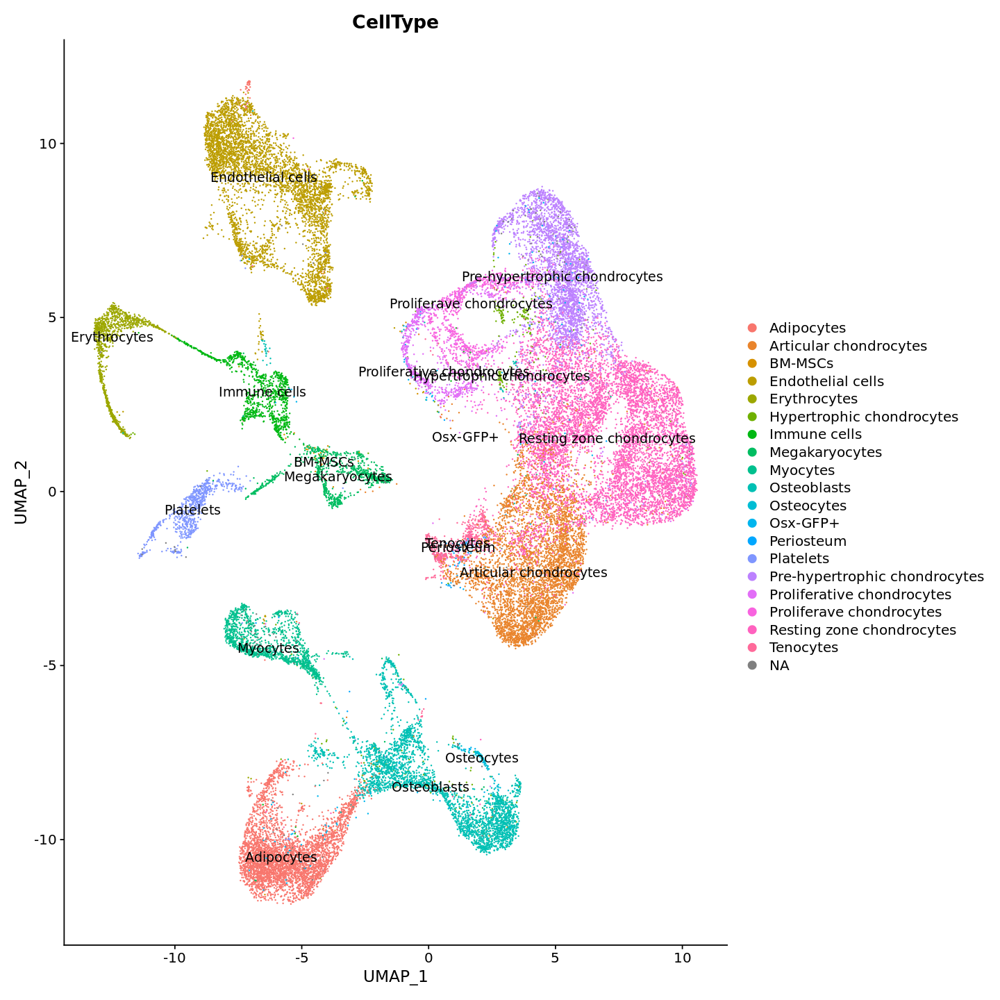

In [28]:
options(repr.plot.width = 12, repr.plot.height = 12)

DimPlot(gp.combined, group.by = "CellType", label = T)

In [72]:
gp.combined@meta.data$CellType <- revalue(gp.combined@meta.data$CellType, c("Proliferave chondrocytes"="Proliferative chondrocytes"))

In [78]:
chondro.1 <- grep("Resting zone chondrocytes", gp.combined$CellType)
chondro.2 <- grep("Proliferative chondrocytes", gp.combined$CellType)
chondro.3 <- grep("Pre-hypertrophic chondrocytes", gp.combined$CellType)
chondro.4 <- grep("Hypertrophic chondrocytes", gp.combined$CellType)
chondro.5 <- grep("Articular chondrocytes", gp.combined$CellType)

gp.chondrocytes <- c(chondro.1, chondro.2, chondro.3, chondro.4)

In [79]:
barcodes <- rownames(gp.combined@meta.data[gp.chondrocytes,])

In [2]:
sca <- readRDS(file = "Full//RDataSessions/SCA_v.0.5.0_with3D_preprint_correctedCounts.Rds")
sca

An object of class Seurat 
71392 features across 150800 samples within 3 assays 
Active assay: RNA (42049 features, 0 variable features)
 2 other assays present: originalexp, integrated
 3 dimensional reductions calculated: pca, umap, umap_3d

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



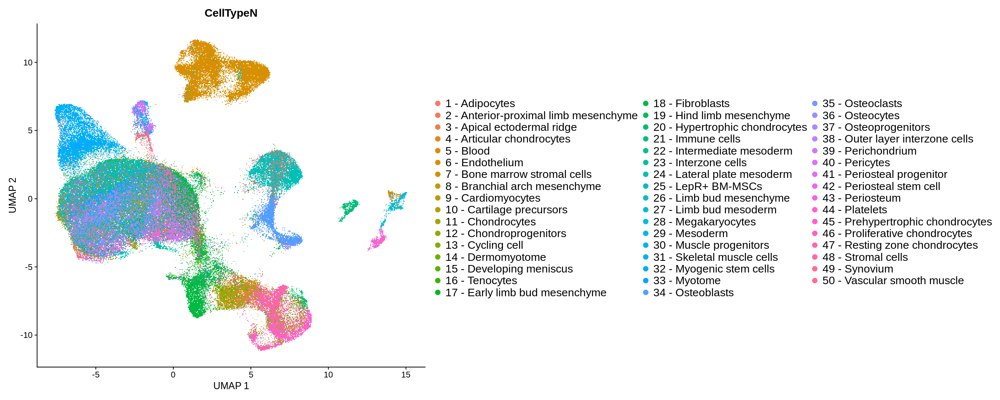

In [5]:
options(repr.plot.width = 20, repr.plot.height = 8 , ggrepel.max.overlaps = Inf)

DimPlot(sca, group.by = "CellTypeN", order = rev(gtools::mixedsort(levels(as.factor(sca$CellTypeN))))) + 
    theme(legend.text = element_text(size = 16)) +
    theme(legend.key.height = unit(6, 'mm'),
          legend.key.width = unit(1, 'mm')) + 
    guides(fill=guide_legend(ncol = 2)) +
    xlab("UMAP 1") + ylab("UMAP 2")

# Add embedding coordinates to metadata
The web app queries the metadata of the final loom file. This includes the UMAP coordinates in 2D and 3D. These therefore need to be added to the metadata prior to conversion.

In [24]:
DefaultAssay(sca) <- "RNA"
sca

An object of class Seurat 
71392 features across 150800 samples within 3 assays 
Active assay: RNA (42049 features, 0 variable features)
 2 other assays present: originalexp, integrated
 3 dimensional reductions calculated: pca, umap, umap_3d

In [30]:
# 2D coordinates
sca <- AddMetaData(sca, metadata = as.data.frame(sca@reductions$umap@cell.embeddings))
# 3D coordinates
sca <- AddMetaData(sca, metadata = as.data.frame(sca@reductions$umap_3d@cell.embeddings))

## Convert to h5ad for easy transfer to Python

In [38]:
sceasy::convertFormat(sca, from = "seurat", to = "anndata",
                       outFile = 'sca.h5ad')

Warning message in .regularise_df(obj@meta.data, drop_single_values = drop_single_values):
“Dropping single category variables:Organism”


AnnData object with n_obs × n_vars = 150800 × 42049
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'id', 'sex', 'day', 'Total_mRNAs', 'tsne_1', 'tsne_2', 'Main_Cluster', 'sub_tsne_1', 'sub_tsne_2', 'Sub_Cluster', 'db_score', 'detected_doublet', 'potential_doublet_cluster', 'percent.mito', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'CC.Difference', 'RNA_snn_res.1.5', 'seurat_clusters', 'Annotation', 'labels', 'DevTP', 'Dataset', 'Tech', 'Author', 'CellType', 'Origin', 'Identity', 'percent.mt', 'RNA_snn_res.0.5', 'RNA_snn_res.0.11', 'Cells', 'is_cell_control', 'total_features_by_counts', 'log10_total_features_by_counts', 'total_counts', 'log10_total_counts', 'pct_counts_in_top_50_features', 'pct_counts_in_top_100_features', 'pct_counts_in_top_200_features', 'pct_counts_in_top_500_features', 'total_features_by_counts_endogenous', 'log10_total_features_by_counts_endogenous', 'total_counts_endogenous', 'log10_total_counts_endogenous', 'pct_counts_endogenous', 'pct_counts_in_top_50_

## Convert to SingleCellExperiment for additional analyses in R or conversion to loom

In [39]:
sceasy::convertFormat(sca, from = "seurat", to = "sce",
                       outFile = 'sca.rds')

class: SingleCellExperiment 
dim: 42049 150800 
metadata(0):
assays(2): counts logcounts
rownames(42049): Xkr4 Gm37180 ... n-R5s7 n-R5s85
rowData names(0):
colnames(150800): sci3-me-164.TAAGACCGTAACGGACCAA
  sci3-me-115.GCGGAGAATAGTAAGCATA ... ERR3428140 ERR3428141
colData names(92): orig.ident nCount_RNA ... umap_3d_3 ident
reducedDimNames(3): PCA UMAP UMAP_3D
mainExpName: RNA
altExpNames(0):

## Convert to loom for web app and portability 

In [41]:
sce_object <- readRDS(file = "sca.rds")

In [43]:
sceasy::convertFormat(sce_object, from = "sce", to = "loom",
                       outFile = "sca.loom")

You created a large dataset with compression and chunking.
The chunk size is equal to the dataset dimensions.
If you want to read subsets of the dataset, you should testsmaller chunk sizes to improve read times.



class: SingleCellLoomExperiment 
dim: 42049 150800 
metadata(0):
assays(2): counts logcounts
rownames(42049): Xkr4 Gm37180 ... n-R5s7 n-R5s85
rowData names(0):
colnames(150800): sci3-me-164.TAAGACCGTAACGGACCAA
  sci3-me-115.GCGGAGAATAGTAAGCATA ... ERR3428140 ERR3428141
colData names(92): orig.ident nCount_RNA ... umap_3d_3 ident
reducedDimNames(3): PCA UMAP UMAP_3D
mainExpName: RNA
altExpNames(0):
rowGraphs(0): NULL
colGraphs(0): NULL

In [47]:
sca

An object of class Seurat 
71392 features across 150800 samples within 3 assays 
Active assay: RNA (42049 features, 0 variable features)
 2 other assays present: originalexp, integrated
 3 dimensional reductions calculated: pca, umap, umap_3d